In [46]:
import datetime

import colormaps
import matplotlib.pyplot as plt
import numpy as np
import polars as pl
import xarray as xr
from jetutils.anyspell import get_persistent_jet_spells, mask_from_spells_pl, subset_around_onset, get_persistent_spell_times_from_som, get_spells
from jetutils.clustering import Experiment, RAW_REALSPACE, labels_to_centers
from jetutils.data import DataHandler, open_da, data_path, compute_anomalies_pl
from jetutils.definitions import (
    DATADIR,
    FIGURES,
    PRETTIER_VARNAME,
    YEARS,
    compute,
    get_region,
    infer_direction,
    polars_to_xarray,
    xarray_to_polars,
    labels_to_mask,
    extract_season_from_df,
    DUNCANS_REGIONS_NAMES,
    UNITS
)
from jetutils.jet_finding import JetFindingExperiment, jet_integral_haversine, find_all_jets
from jetutils.plots import COLORS, COLORS_EXT, PINKPURPLE, Clusterplot, gather_normal_da_jets_wrapper, _gather_normal_da_jets_wrapper, make_transparent
from matplotlib.cm import ScalarMappable
from matplotlib.colors import BoundaryNorm
from matplotlib.ticker import MaxNLocator
from pathlib import Path

%load_ext autoreload
%autoreload 2
%matplotlib inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [ ]:
import os
os.environ["PATH"] = f'/storage/homefs/hb22g102/latex/bin/x86_64-linux:{os.environ["PATH"]}'

In [3]:
exp = JetFindingExperiment(DataHandler(f"{DATADIR}/ERA5/plev/high_wind/6H/results/6"))
dh_low = DataHandler.from_specs(
    "ERA5", "plev", "mid_wind", "6H", "all", None, -80, 40, 15, 80, "all"
)
ds = exp.ds
all_jets_one_df = exp.find_jets()
all_jets_one_df = exp.categorize_jets(dh_low.da["s"])
all_jets_one_df, all_jets_over_time, flags = exp.track_jets()
props_as_df_uncat = exp.props_as_df(False)
all_props_over_time = exp.props_over_time(all_jets_over_time, props_as_df_uncat)
jet_pos_da = exp.jet_position_as_da()
props_as_df = pl.read_parquet(exp.path.joinpath("props_as_df_extras.parquet"))

exp_s = Experiment(DataHandler(f"{DATADIR}/ERA5/plev/high_wind/6H/results/2"))
da_s = exp_s.da
da_s = da_s.sel(time=da_s.time.dt.hour == 0)

ds_ = ds.sel(time=ds.time.dt.hour == 0)
ds_ = ds_.sel(time=ds_.time.dt.season == "JJA")
all_jets_one_df = all_jets_one_df.cast({"time": pl.Datetime("ms")})
all_jets_one_df = all_jets_one_df.with_columns((pl.col("is_polar").mean().over(["time", "jet ID"]) > 0.5).cast(pl.Int8).alias("jet ID"))
all_jets_one_df = all_jets_one_df.sort("time", "jet ID", "lon")

In [4]:
da_T = open_da("ERA5", "surf", "t2m", "dailymean", "all", "JJA", *get_region(ds), "all", 'dayofyear', {'dayofyear': ('win', 15)}, None,)
da_T = compute(da_T, progress_flag=True)
da_tp = open_da("ERA5", "surf", "tp", "dailysum", "all", "JJA", *get_region(ds), "all", 'dayofyear', {'dayofyear': ('win', 15)}, None,)
da_tp = compute(da_tp, progress_flag=True)
da_apvs = open_da("ERA5", "thetalev", "apvs", "dailyany", "all", "JJA", *get_region(ds), "all", 'dayofyear', {'dayofyear': ('win', 15)}, None,)
da_apvs = compute(da_apvs, progress_flag=True)
da_cpvs = open_da("ERA5", "thetalev", "cpvs", "dailyany", "all", "JJA", *get_region(ds), "all", 'dayofyear', {'dayofyear': ('win', 15)}, None,)
da_cpvs = compute(da_cpvs, progress_flag=True)
da_z = open_da("ERA5", "plev", "z", "dailymean", "all", "JJA", *get_region(ds), 500, 'dayofyear', {'dayofyear': ('win', 15)}, None,)
da_z = compute(da_z, progress_flag=True)

[########################################] | 100% Completed | 56.06 s
[########################################] | 100% Completed | 52.70 s
[########################################] | 100% Completed | 157.70 s
[########################################] | 100% Completed | 154.29 s
[########################################] | 100% Completed | 146.32 s


# Define all jet spells once

In [5]:
spells_from_jet_daily_stj_cs = get_persistent_jet_spells(
    props_as_df,
    "com_speed",
    jet="STJ",
    season="JJA",
    q=0.61,
    daily=True,
    minlen=datetime.timedelta(days=5),
    fill_holes=datetime.timedelta(hours=12),
)
spells_from_jet_daily_edj_cs = get_persistent_jet_spells(
    props_as_df,
    "com_speed",
    jet="EDJ",
    season="JJA",
    q=0.62,
    daily=True,
    minlen=datetime.timedelta(days=6),
    fill_holes=datetime.timedelta(hours=12),
)
spells_from_jet_daily_stj_pe = get_persistent_jet_spells(
    props_as_df,
    "persistence",
    jet="STJ",
    season="JJA",
    q=0.74,
    daily=True,
    minlen=datetime.timedelta(days=9),
    fill_holes=datetime.timedelta(hours=0),
)
spells_from_jet_daily_edj_pe = get_persistent_jet_spells(
    props_as_df,
    "persistence",
    jet="EDJ",
    season="JJA",
    q=0.77,
    daily=True,
    minlen=datetime.timedelta(days=8),
    fill_holes=datetime.timedelta(hours=0),
)
spells_list = {
    "STJ adv. spe": spells_from_jet_daily_stj_cs,
    "EDJ adv. spe": spells_from_jet_daily_edj_cs,
    "STJ lifetime": spells_from_jet_daily_stj_pe,
    "EDJ lifetime": spells_from_jet_daily_edj_pe,
}
for na, spells_ in spells_list.items():
    print(na, spells_["spell"].max())
    
spells_from_jet_daily_stj_cs = get_persistent_jet_spells(
    props_as_df,
    "com_speed",
    jet="STJ",
    season="JJA",
    q=0.61,
    daily=True,
    minlen=datetime.timedelta(days=5),
    fill_holes=datetime.timedelta(hours=12),
    time_before=datetime.timedelta(days=4),
)
spells_from_jet_daily_edj_cs = get_persistent_jet_spells(
    props_as_df,
    "com_speed",
    jet="EDJ",
    season="JJA",
    q=0.62,
    daily=True,
    minlen=datetime.timedelta(days=6),
    fill_holes=datetime.timedelta(hours=12),
    time_before=datetime.timedelta(days=4),
)
spells_from_jet_daily_stj_pe = get_persistent_jet_spells(
    props_as_df,
    "persistence",
    jet="STJ",
    season="JJA",
    q=0.74,
    daily=True,
    minlen=datetime.timedelta(days=9),
    fill_holes=datetime.timedelta(hours=0),
    time_before=datetime.timedelta(days=4),
)
spells_from_jet_daily_edj_pe = get_persistent_jet_spells(
    props_as_df,
    "persistence",
    jet="EDJ",
    season="JJA",
    q=0.77,
    daily=True,
    minlen=datetime.timedelta(days=8),
    fill_holes=datetime.timedelta(hours=0),
    time_before=datetime.timedelta(days=4),
)
spells_list_time_before = {
    "STJ adv. spe": spells_from_jet_daily_stj_cs,
    "EDJ adv. spe": spells_from_jet_daily_edj_cs,
    "STJ lifetime": spells_from_jet_daily_stj_pe,
    "EDJ lifetime": spells_from_jet_daily_edj_pe,
}


STJ adv. spe 23
EDJ adv. spe 22
STJ lifetime 24
EDJ lifetime 24


# compare with SOM persistence

In [6]:
def extract_dynamical_seasons(labels: pl.DataFrame, len_spring: int = 20):    
    labels = labels.cast({"time": pl.Datetime("ms")})
    summer_cluster = labels.filter(pl.col("time").dt.month() == 7)["labels"].mode().item()
    seasons = labels.group_by(
        pl.col("time").dt.year().alias("year")
    ).agg(
        pl.col("time").get((pl.col("labels") == summer_cluster).arg_true().first()).alias("start"),
        pl.col("time").get((pl.col("labels") == summer_cluster).arg_true().last()).alias("end")
    ).with_columns(
        spring=pl.datetime_ranges(pl.col("start") - datetime.timedelta(days=len_spring), pl.col("start"), "6h"),
        summer=pl.datetime_ranges(pl.col("start"), pl.col("end"), "6h"),
        autumn=pl.datetime_ranges(pl.col("end"), pl.col("end") + datetime.timedelta(days=len_spring), "6h"),
    ).drop("year", "start", "end")
    return [seasons[season].explode().sort() for season in seasons.columns]

dh = DataHandler(f"{DATADIR}/ERA5/plev/high_wind/6H/results/3")
exp_wind = Experiment(dh)
centers_kmeans, labels_kmeans = exp_wind.do_kmeans(7, 200)
spring, summer, autumn = extract_dynamical_seasons(xarray_to_polars(labels_kmeans), 20)
summer_daily = summer.filter(summer.dt.hour() == 0)
da_summer = dh.da.sel(time=summer.to_numpy())
dh_summer = DataHandler.from_basepath_and_da(exp_wind.path.parent, da_summer, save_da=True)
exp_summer = Experiment(dh_summer)
nx, ny, n_pca = 4, 4, 200
net, centers, labels = exp_summer.som_cluster(
    nx,
    ny,
    n_pca,
    sigma=1.5,
    sigmaN=1e-5,
    train_kwargs=dict(num_epochs=20),
    init="pca",
)
populations = net.compute_populations()
coords = net.neighborhoods.coordinates
from sklearn.metrics import pairwise_distances
dists = pairwise_distances(net.weights)
spells = get_persistent_spell_times_from_som(labels, dists, 0, 24, nt_before=20, nojune=True, daily=True)
spells = spells.cast({"time": pl.Datetime("ms"), "relative_time": pl.Duration("ms")})

labels_daily = labels.sel(time=labels.time.dt.hour == 0)
mask_daily = labels_to_mask(labels_daily)
jets_daily = all_jets_one_df.filter(pl.col("time").is_in(summer_daily))

spells_per_cluster = spells.filter(pl.col("relative_index") == 0).group_by("value").len()
spells_per_cluster = pl.Series("value", np.arange(net.n_nodes)).to_frame().join(spells_per_cluster, how="left", on="value").fill_null(0)
numbering = [f"{numb + 1}, {spells_per_cluster[int(numb), 'len']}" for numb in range(net.n_nodes)]

props_as_df_anoms = compute_anomalies_pl(props_as_df, ("jet", ), 31, True)
props_masked = mask_from_spells_pl(spells, props_as_df_anoms, time_before=datetime.timedelta(days=5))
props_masked_ = props_masked.group_by(pl.col("value"), pl.col("relative_index"), pl.col("jet")).mean().rename({"value": "cluster"})
indexer = pl.Series("cluster", np.arange(net.n_nodes)).to_frame().join(props_masked[:, ["jet", "relative_index"]].unique(("jet", "relative_index")), how="cross").sort("cluster", "jet", "relative_index")
props_masked_ = indexer.join(props_masked_, how="left", on=["cluster", "jet", "relative_index"])
spells_list[f"SOM"] = spells
spells_list_extended = spells_list.copy()
for cluster in range(net.n_nodes):
    spells_list_extended[f"SOM cluster {cluster}"] = spells.filter(pl.col("value") == cluster)

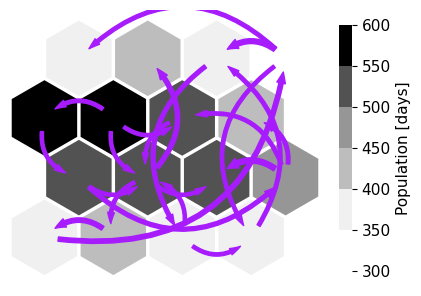

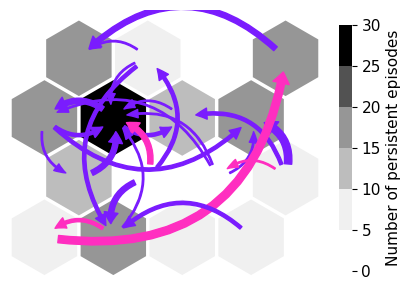

In [7]:
import matplotlib.patches as patches
import polars.selectors as cs
from itertools import product

# What happens before?
spells = get_persistent_spell_times_from_som(labels, dists, 0, 24, nt_before=1, nojune=False, daily=False)
spells = spells.cast({"time": pl.Datetime("ms"), "relative_time": pl.Duration("ms")})
spells_any = get_persistent_spell_times_from_som(labels, dists, 0, 1, nt_before=1, nojune=False, daily=False)
spells_any = spells_any.cast({"time": pl.Datetime("ms"), "relative_time": pl.Duration("ms")})
longest_spell = spells.group_by("value").agg(pl.col("time").filter(pl.col("len") == pl.col("len").max())).explode("time").join(spells, on=["value", "time"]).sort("value", "time")

labels_masked = spells.join(xarray_to_polars(labels).cast({"time": pl.Datetime("ms")}), on="time")
labels_any_masked = spells_any.join(xarray_to_polars(labels).cast({"time": pl.Datetime("ms")}), on="time")
labels_longest_masked = longest_spell.join(xarray_to_polars(labels).cast({"time": pl.Datetime("ms")}), on="time")
rel_ind = -1
index = pl.int_range(0, 16, eager=True).rename("labels").to_frame()
transitions_any = index.clone()
transitions_spell = index.clone()
transitions_longest = index.clone()

for i in range(16):
    a = labels_any_masked.filter(pl.col("value") == i, pl.col("relative_index") == rel_ind)["labels"].value_counts(sort=True)
    transitions_any = transitions_any.join(a.rename({"count": f"trans to {i}"}), on="labels", how="left")
    a = labels_masked.filter(pl.col("value") == i, pl.col("relative_index") == rel_ind)["labels"].value_counts(sort=True)
    transitions_spell = transitions_spell.join(a.rename({"count": f"trans to {i}"}), on="labels", how="left")
    a = labels_longest_masked.filter(pl.col("value") == i, pl.col("relative_index") == rel_ind)["labels"].value_counts(sort=True)
    transitions_longest = transitions_longest.join(a.rename({"count": f"trans to {i}"}), on="labels", how="left")

## spells per cluster

spells_per_cluster = spells.filter(pl.col("relative_index") == 0).group_by("value").len()
spells_per_cluster = pl.Series("value", np.arange(net.n_nodes)).to_frame().join(spells_per_cluster, how="left", on="value").fill_null(0)
cmap = colormaps.greys
transitions_any_ = transitions_any.fill_null(0).with_columns(cs.contains("trans") / cs.contains("trans").sum())
transitions_spell_ = transitions_spell.fill_null(0).with_columns(cs.contains("trans") / cs.contains("trans").sum())
fig, ax = net.plot_on_map(populations / 4, cmap=cmap, discretify=True, cbar_kwargs={"shrink": 0.8, "label": "Population [days]"})
thresh = 0.25
arrowcount = 0
for i, j in product(range(16), range(16)):
    if i == j:
        continue
    strength = transitions_spell_.fill_null(0)[i, f"trans to {j}"]
    if strength < thresh:
        continue
    arrowcount += 1
    tail_width = ((strength - thresh + 1) * 2) ** 1.2
    head_width = tail_width * 2
    style = f"Simple, tail_width={tail_width:.3f}, head_width={head_width:.3f}, head_length=8"
    kw = dict(arrowstyle=style, connectionstyle="arc3,rad=.5", color=COLORS[0], shrinkA=10, shrinkB=10)
    ax.add_patch(patches.FancyArrowPatch(coords[i], coords[j], **kw))
## spells per cluster
fig.savefig(f"{FIGURES}/Poster_EGU25/transi_any.png")

spells_per_cluster = spells.filter(pl.col("relative_index") == 0).group_by("value").len()
spells_per_cluster = pl.Series("value", np.arange(net.n_nodes)).to_frame().join(spells_per_cluster, how="left", on="value").fill_null(0)
cmap = colormaps.greys
transitions_any_ = transitions_any.fill_null(0).with_columns(cs.contains("trans") / cs.contains("trans").sum())
transitions_spell_ = transitions_spell.fill_null(0).with_columns(cs.contains("trans") / cs.contains("trans").sum())
fig, ax = net.plot_on_map(spells_per_cluster["len"].to_numpy(), cmap=cmap, discretify=True, cbar_kwargs={"shrink": 0.8, "label": "Number of persistent episodes"})
thresh = 3
arrowcount = 0
for i, j in product(range(16), range(16)):
    if i == j:
        continue
    strength = transitions_spell.fill_null(0)[i, f"trans to {j}"]
    is_longest = transitions_longest[i, f"trans to {j}"] is not None
    if strength < 3:
        continue
    arrowcount += 1
    tail_width = (strength - thresh + 1) ** 1.2
    head_width = strength * 2
    color = COLORS[2] if is_longest else COLORS[1]
    style = f"Simple, tail_width={tail_width:.3f}, head_width={head_width:.3f}, head_length=8"
    kw = dict(arrowstyle=style, connectionstyle="arc3,rad=.5", color=color, shrinkA=10, shrinkB=10)
    ax.add_patch(patches.FancyArrowPatch(coords[i], coords[j], **kw))
fig.savefig(f"{FIGURES}/Poster_EGU25/transi_hs.png")

In [8]:
da = ds["s"].sel(time=ds.time.dt.season=="JJA").chunk("auto")
speed_realspace = ((da.data[1:] - da.data[:-1])  ** 2).sum(axis=(1, 2))
speed_realspace = compute(speed_realspace, progress_flag=True)
speed_realspace = pl.DataFrame({"time": da.time.values[1:], "speed": speed_realspace})
spells_list["abs"] = get_spells(speed_realspace, pl.col("speed") < pl.col("speed").quantile(0.06))
spells_list_extended["abs"] = spells_list["abs"]

[                                        ] | 0% Completed | 411.54 us

[########################################] | 100% Completed | 19.23 s


In [9]:
file_errors_location = f'{DATADIR}/ERA5/heatwaves_duncan/heatwaves_duncan.xlsx'
df = pl.read_excel(file_errors_location)
for i in range(1, 7):
    dates = f"dates{i}"
    duration = f"duration{i}"
    df_ = df[[duration, dates]].filter(pl.col(duration) > 3)
    df_ = df_.with_columns(
        start=pl.col(dates).str.split("/").list.get(0).str.strptime(pl.Datetime), 
        end=pl.col(dates).str.split("/").list.get(1).str.strptime(pl.Datetime)
    )
    df_ = df_.with_columns(time=pl.date_ranges(pl.col("start"), pl.col("end")))
    df_ = df_.drop(dates, duration, "start", "end")
    df_ = df_.with_row_index(name="spell").explode("time")
    spells_list[DUNCANS_REGIONS_NAMES[i - 1]] = df_
    spells_list_extended[DUNCANS_REGIONS_NAMES[i - 1]] = df_

23
22
24
24
161
11
36
48
53
63
44
46


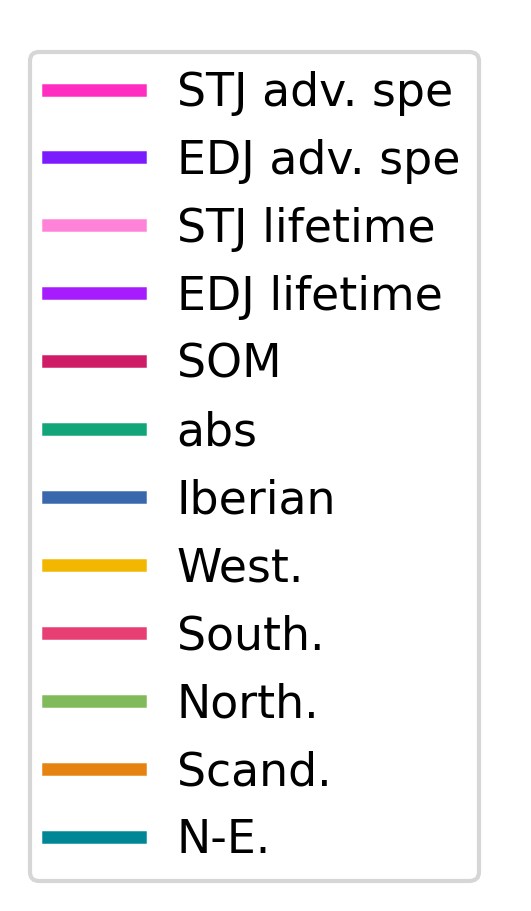

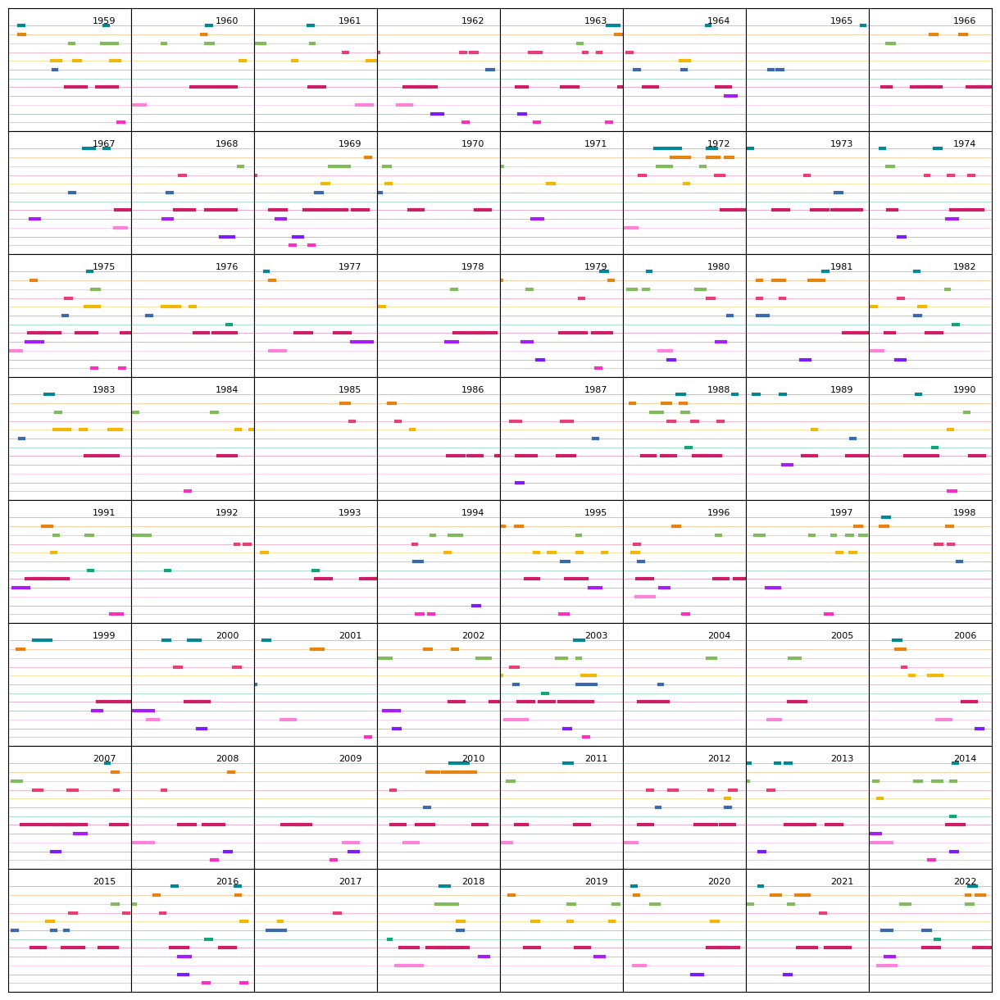

In [10]:
colors = [COLORS[2], COLORS[1], COLORS_EXT[6], COLORS_EXT[1], COLORS[3], *colormaps.bold(np.linspace(0, 1, 11))[1:]]
for spell in spells_list.values():
    print(spell["spell"].max())
fig, ax = plt.subplots(figsize=(2, 2), dpi=300)
ax.axis("off")
for spell_name, color in zip(spells_list, colors):
    ax.plot([], [], color=color, lw=3, label=spell_name)
ax.legend()
plt.show()
fig, axes = plt.subplots(8, 8, figsize=(12, 12), gridspec_kw=dict(wspace=0, hspace=0, left=0, right=1, bottom=0, top=1), subplot_kw=dict(xticks=[], yticks=[], xlim=[-1, 95], ylim=[-1, 13]))
axes = axes.ravel()
for ax, year in zip(axes, YEARS):
    ax.text(65, len(spells_list) - .8, f"{year}", fontsize=8)
    for j, (name_, spell) in enumerate(spells_list.items()):
        ax.plot([-1, 95], [j, j], color=colors[j], lw=.5, ls="solid", alpha=0.5)
        spell_ = spell.filter(pl.col("time").dt.year() == year)
        if len(spell_) == 0:
            continue
        for s, indiv_spell in spell_.group_by("spell"):
            x = [indiv_spell["time"].dt.ordinal_day().first() - 152, indiv_spell["time"].dt.ordinal_day().last() - 152]
            y = [j, j]
            ax.plot(x, y, color=colors[j], lw=3)    

Text(0.5, 1.0, 'Persistent episode frequency')

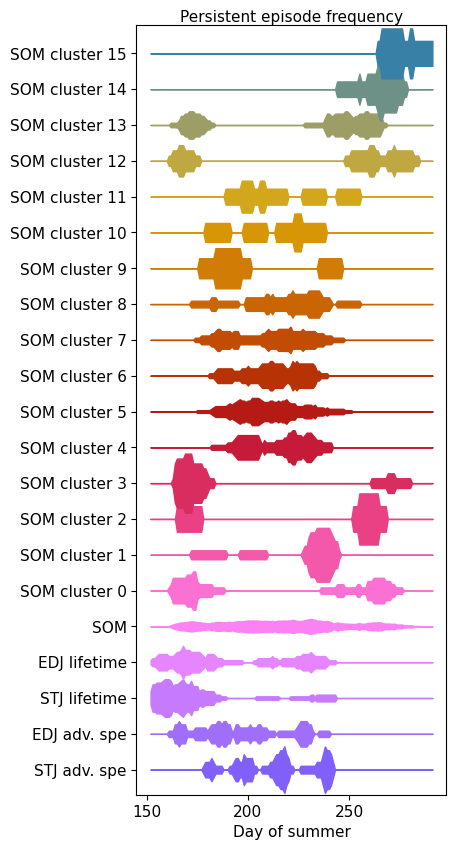

In [11]:
fig, ax = plt.subplots(figsize=(4, 10))
keys = [key for key in spells_list_extended if key not in [*DUNCANS_REGIONS_NAMES, "abs"]]
colors = colormaps.cet_c_mrybm_35(np.linspace(0.1, 0.9, len(keys)))
dy = 0.07
spells_list_reduced = [spells_list_extended[key][["spell", "time"]].with_columns(type=pl.lit(key)).cast({"time": pl.Datetime("ms")}) for key in keys]
counts = pl.concat(spells_list_reduced).group_by(pl.col("time").dt.ordinal_day().alias("dayofyear"), pl.col("type"), maintain_order=True).len()
counts = counts[["dayofyear"]].unique("dayofyear").join(counts[["type"]].unique("type"), how="cross").join(counts, how="left", on=["dayofyear", "type"]).fill_null(0)
counts = counts.with_columns(prop=(pl.col("len") / pl.col("len").sum()).over("type"))
for i, key in enumerate(keys):
    subdf = counts.filter(pl.col("type") == key)
    subdf = subdf.sort("dayofyear")
    ax.fill_between(subdf["dayofyear"], i * dy + subdf["prop"], i * dy - subdf["prop"], color=colors[i % len(colors)])
ax.set_ylim([-dy * 0.7, (i + 0.8) * dy])
ax.set_xlabel("Day of summer")
ax.set_yticks(dy * np.arange(len(keys)), labels=keys)
ax.set_title("Persistent episode frequency")

In [12]:
if "SOM" in spells_list_extended:
    del spells_list_extended["SOM"]
if "abs" in spells_list_extended:
    del spells_list_extended["abs"]
overlaps = np.zeros((len(spells_list_extended), len(spells_list_extended)))
for i, val1 in enumerate(spells_list_extended.values()):
    for j, val2 in enumerate(spells_list_extended.values()):
        overlaps[i, j] = val1["time"].cast(pl.Datetime("ms")).is_in(val2["time"].cast(pl.Datetime("ms"))).mean()

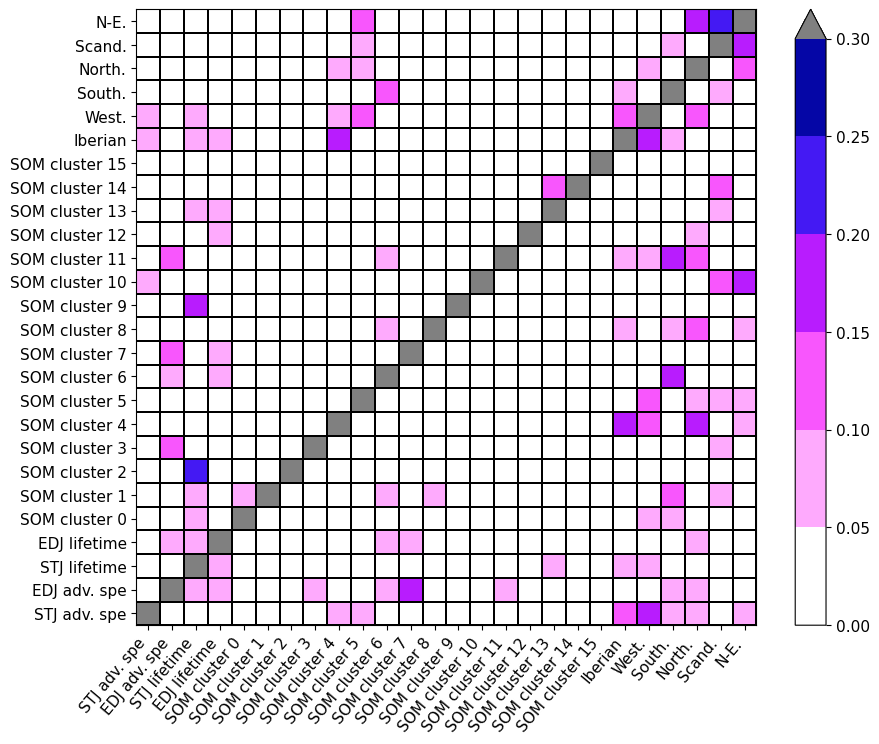

In [13]:
fig, ax = plt.subplots(figsize=(10, 8))
levels = np.arange(0, 0.33, 0.05)
cmap = colormaps.cet_l_bmw_r
cmap = make_transparent(cmap, len(levels), 1)
cmap.set_over("grey")
norm = BoundaryNorm(levels, cmap.N, extend="max")
im = ax.pcolormesh(overlaps, cmap=cmap, norm=norm, lw=0.1, ls="solid", edgecolor="black")
fig.colorbar(im, ax=ax)
ax.set_xticks(np.arange(len(spells_list_extended)) + 0.5, list(spells_list_extended), ha="right", rotation=50)
ax.set_yticks(np.arange(len(spells_list_extended)) + 0.5, list(spells_list_extended))
a = 1

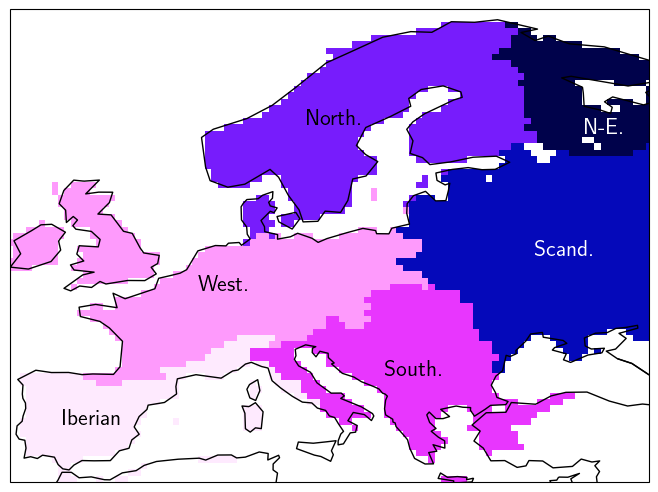

In [54]:
clusters_da = np.abs(xr.open_dataarray(Path(DATADIR, "ERA5/heatwaves_duncan/cluster_df.nc")).load())
clu = Clusterplot(1, 1, (-10, 40, 35, 72))
cmap = colormaps.cet_l_bmw_r
ax = clu.axes[0]
unique_clusters = np.arange(1, 7)
norm = BoundaryNorm(np.concatenate([[-1], unique_clusters]) + 0.5, cmap.N)
clusters_da.plot(
    ax=ax,
    cmap=cmap,
    norm=norm,
    add_colorbar=False,
    add_labels=False
)
for j in range(6):
    lo = clusters_da.lon.where(clusters_da==(j + 1)).mean().item() - j - 2 * (j == 0) + 2 * (j == 2) + 1.5 * (j == 1) - (j == 4)
    la = clusters_da.lat.where(clusters_da==(j + 1)).mean().item() - (j == 5) * 2
    color = "white" if j >= 4 else "black"
    ax.text(lo, la, DUNCANS_REGIONS_NAMES[j], ha="center", va="center", fontweight="bold", color=color)
    
plt.savefig(f"{FIGURES}/Poster_EGU25/centers.png")

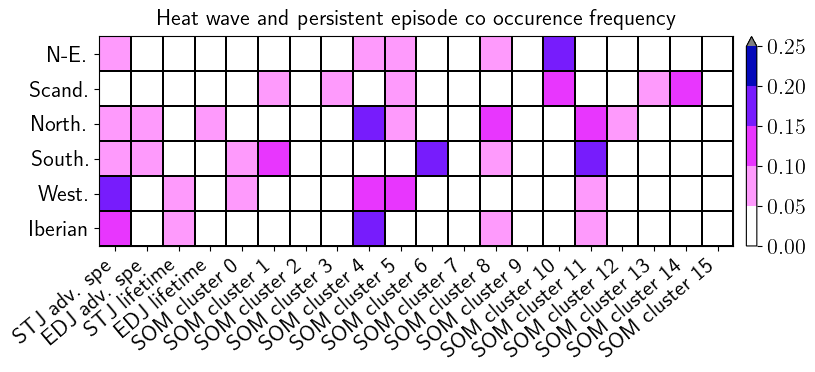

In [52]:
plt.style.use('default')
plt.rc("xtick", labelsize=16)
plt.rc("ytick", labelsize=16)
plt.rc("axes", labelsize=16)
plt.rc("axes", titlesize=16)
plt.rc("font", size=16)
plt.rc("text", usetex=True)
plt.rc("savefig", dpi=300)

fig, ax = plt.subplots(figsize=(10, 4), tight_layout=False)
levels = np.arange(0, 0.26, 0.05)
cmap = colormaps.cet_l_bmw_r
cmap = make_transparent(cmap, len(levels), 1)
cmap.set_over("grey")
norm = BoundaryNorm(levels, cmap.N, extend="max")
im = ax.pcolormesh(overlaps[:-6, -6:].T, cmap=cmap, norm=norm, lw=0.1, ls="solid", edgecolor="black")
fig.colorbar(im, ax=ax, fraction=0.25, shrink=1, pad=0.015)
ax.set_title("Heat wave and persistent episode co occurence frequency", pad=8)
ax.set_yticks(np.arange(6) + 0.5, list(spells_list_extended)[-6:], ha="right", rotation=0)
ax.set_xticks(np.arange(len(spells_list_extended) - 6) + 0.5, list(spells_list_extended)[:-6], rotation=40, ha="right")
plt.savefig(f"{FIGURES}/Poster_EGU25/heat_waves_co_occurence.png")

# Natural coordinates composites

In [22]:
def symmetrize_p(pvals: xr.DataArray | np.ndarray, direction: int, q: float) -> np.ndarray:
    if direction == 0:
        return np.amin([pvals * 2, (1 - pvals) * 2], axis=0) < q
    if direction == 1:
        return np.asarray(pvals) > 1 - q
    return np.asarray(pvals) < q


def plot_all_relative_composites(jets, times, variable_dict, n_bootstraps: int = 50):
    figs = []
    for varname, props in variable_dict.items():
        if len(props) == 3:
            da, nlevels, cmap = props
            clim = None
        else:
            da, clim, nlevels, cmap = props
        hatch = "xxx" if varname == "tp" else "xx"
        
        jets_during_spells_with_interp_norm_ds = gather_normal_da_jets_wrapper(jets, times, da, n_bootstraps=n_bootstraps, clim=clim)
        try:
            to_plot = jets_during_spells_with_interp_norm_ds[da.name + "_interp"]
            pvals = jets_during_spells_with_interp_norm_ds["pvals"]
        except KeyError:
            to_plot = jets_during_spells_with_interp_norm_ds
            
        direction = infer_direction(to_plot)
        symmetric = direction == 0

        fig, axes = plt.subplots(1, 2, figsize=(10, 4))
        levels = MaxNLocator(nlevels, symmetric=symmetric).tick_values(to_plot.quantile(0.01), to_plot.quantile(0.99))
        norm = BoundaryNorm(levels, cmap.N)
        
        axes[0].pcolormesh(to_plot.norm_index, to_plot.n, to_plot[0].T, norm=norm, cmap=cmap)
        filter_ = symmetrize_p(pvals[0].T, direction, 0.05)
        axes[0].pcolor(pvals.norm_index, pvals.n, pvals[0].T.where(filter_), hatch=hatch, alpha=0.)
        
        axes[1].pcolormesh(to_plot.norm_index, to_plot.n, to_plot[1].T, norm=norm, cmap=cmap)
        filter_ = symmetrize_p(pvals[1].T, direction, 0.05)
        axes[1].pcolor(pvals.norm_index, pvals.n, pvals[0].T.where(filter_), hatch=hatch, alpha=0.)

        fig.colorbar(ScalarMappable(norm, cmap), ax=axes, spacing="proportional")
        figs.append(fig)
    return figs

# clim_T = xr.open_dataarray(exp.path.joinpath("t2m_relative_clim.nc"))
# clim_tp = xr.open_dataarray(exp.path.joinpath("tp_relative_clim.nc"))
# clim_apvs = xr.open_dataarray(exp.path.joinpath("apvs_relative_clim.nc"))
# clim_cpvs = xr.open_dataarray(exp.path.joinpath("cpvs_relative_clim.nc"))
# clim_sst = xr.open_dataarray(exp.path.joinpath("sst_relative_clim.nc"))

# variable_dict = {
#     "t2m": [da_T, clim_T, 8, colormaps.BlWhRe],
#     "tp": [da_tp, clim_tp, 15, colormaps.precip4_diff_19lev],
#     "APVS": [da_apvs, clim_apvs, 7, colormaps.curl],
#     "CPVS": [da_cpvs, clim_cpvs, 7, colormaps.curl],
#     "sst": [da_sst, clim_sst, 7, colormaps.BlWhRe]
# }
variable_dict = {
    "t2m": [da_T, 8, colormaps.BlWhRe],
    "tp": [da_tp * 1000, 15, colormaps.precip4_diff_19lev],
    "apvs": [da_apvs * 100, 7, colormaps.curl],
    "cpvs": [da_cpvs * 100, 7, colormaps.curl],
}
long_names = {
    "t2m": "2m temperature [K]",
    "tp": "Daily accum. precip. [mm]",
    "apvs": r"Anticyclonic PV streamer freq [$\%$]",
    "cpvs": r"Cyclonic PV streamer freq [$\%$]",
}

## Mean anomaly at onset

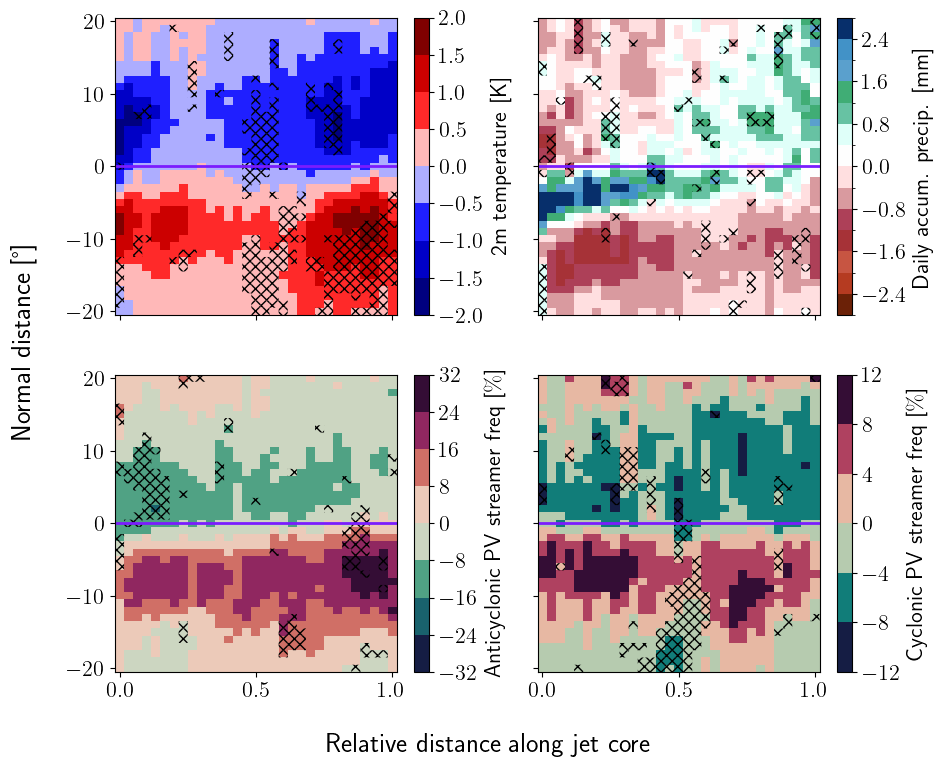

In [53]:
plt.rc("xtick", labelsize=16)
plt.rc("ytick", labelsize=16)
plt.rc("axes", labelsize=16)
plt.rc("font", size=16)
plt.rc("savefig", dpi=300)


spells_from_jet = spells_list_time_before["EDJ lifetime"]
spells_from_jet = subset_around_onset(spells_from_jet, around_onset=datetime.timedelta(days=1))
jets = all_jets_one_df.filter(pl.col("time").dt.hour() == 0, pl.col("time").dt.month().is_in([6, 7, 8]))
spells_from_jet = spells_from_jet.filter(pl.col("time").dt.month().is_in([6, 7, 8]))
fig, axes = plt.subplots(2, 2, figsize=(10, 8.5), sharex="all", sharey="all", gridspec_kw=dict(wspace=0.2))
axes = axes.ravel()
times = spells_from_jet
n_bootstraps = 200
for i, (varname, props) in enumerate(variable_dict.items()):
    ax = axes[i]
    if len(props) == 3:
        da, nlevels, cmap = props
        clim = None
    else:
        da, clim, nlevels, cmap = props
    hatch = "xxx"
    
    jets_during_spells_with_interp_norm_ds = gather_normal_da_jets_wrapper(jets, times, da, n_bootstraps=n_bootstraps, clim=clim)
    try:
        to_plot = jets_during_spells_with_interp_norm_ds[da.name + "_interp"]
        pvals = jets_during_spells_with_interp_norm_ds["pvals"]
    except KeyError:
        to_plot = jets_during_spells_with_interp_norm_ds
        
    direction = infer_direction(to_plot)
    symmetric = direction == 0

    levels = MaxNLocator(nlevels, symmetric=symmetric).tick_values(to_plot.quantile(0.01), to_plot.quantile(0.99))
    norm = BoundaryNorm(levels, cmap.N)
    
    ax.pcolormesh(to_plot.norm_index, to_plot.n, to_plot[1].T, norm=norm, cmap=cmap)
    filter_ = symmetrize_p(pvals[1].T, direction, 0.1)
    ax.pcolor(pvals.norm_index, pvals.n, pvals[1].T.where(filter_), hatch=hatch, alpha=0.)
    xlim = ax.get_xlim()
    ax.plot((-.1, 1.1), (0, 0), lw=2, color=COLORS[1])
    ax.set_xlim(xlim)
    cbar = fig.colorbar(ScalarMappable(norm, cmap), ax=ax, spacing="proportional")
    cbar.set_label(long_names[varname], fontsize=16)

fig.supylabel("Normal distance [°]")
fig.supxlabel("Relative distance along jet core")
plt.draw()

plt.savefig(f"{FIGURES}/Poster_EGU25/relative_composites.png")

[<Figure size 1000x400 with 3 Axes>,
 <Figure size 1000x400 with 3 Axes>,
 <Figure size 1000x400 with 3 Axes>,
 <Figure size 1000x400 with 3 Axes>]

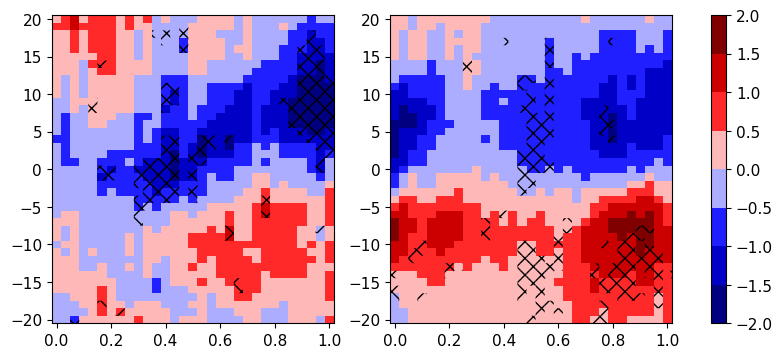

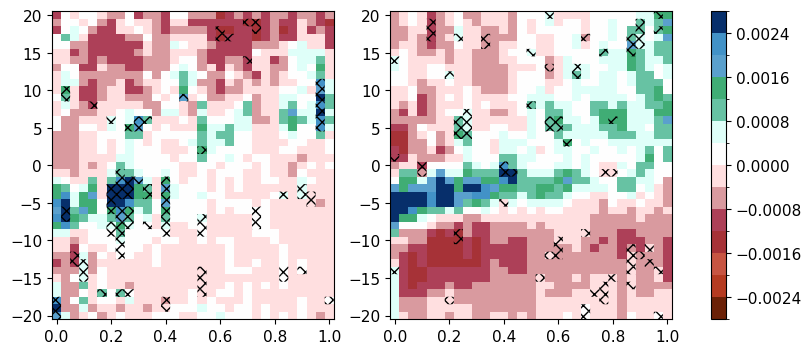

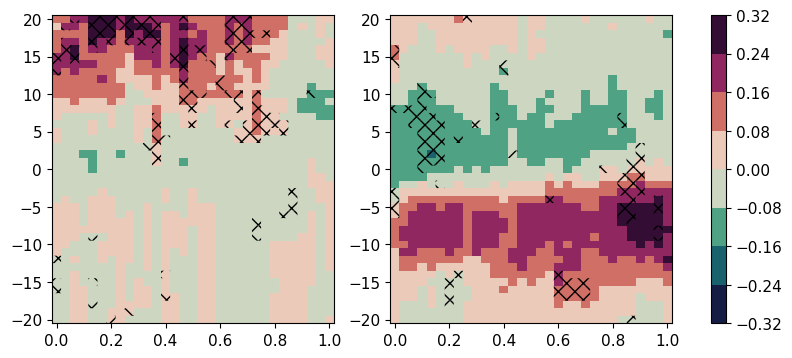

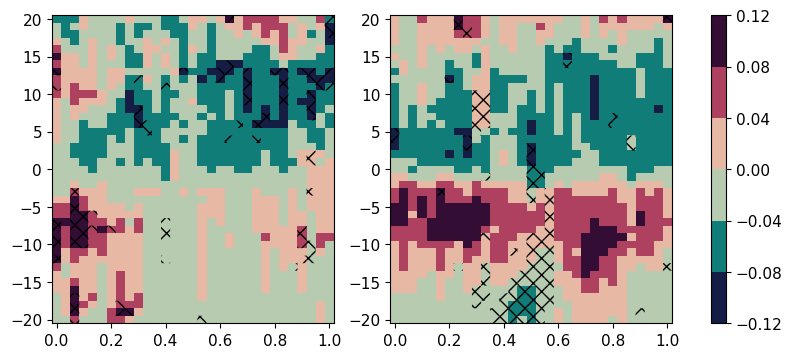

In [12]:
spells_from_jet = spells_list_time_before["EDJ lifetime"]
spells_from_jet = subset_around_onset(spells_from_jet, around_onset=datetime.timedelta(days=1))
jets = all_jets_one_df.filter(pl.col("time").dt.hour() == 0, pl.col("time").dt.month().is_in([6, 7, 8]))
spells_from_jet = spells_from_jet.filter(pl.col("time").dt.month().is_in([6, 7, 8]))

plot_all_relative_composites(jets, spells_from_jet, variable_dict, 50)

[<Figure size 1000x400 with 3 Axes>,
 <Figure size 1000x400 with 3 Axes>,
 <Figure size 1000x400 with 3 Axes>,
 <Figure size 1000x400 with 3 Axes>]

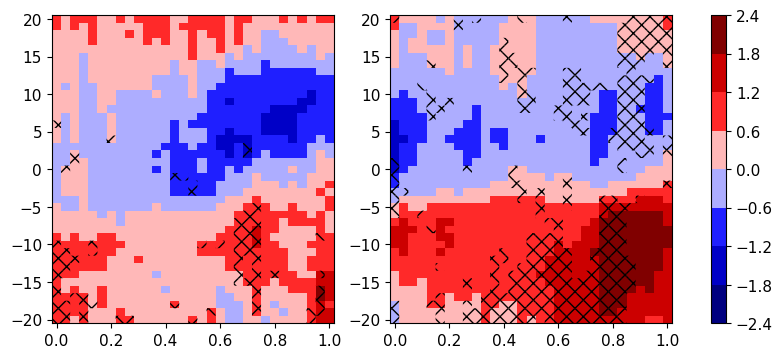

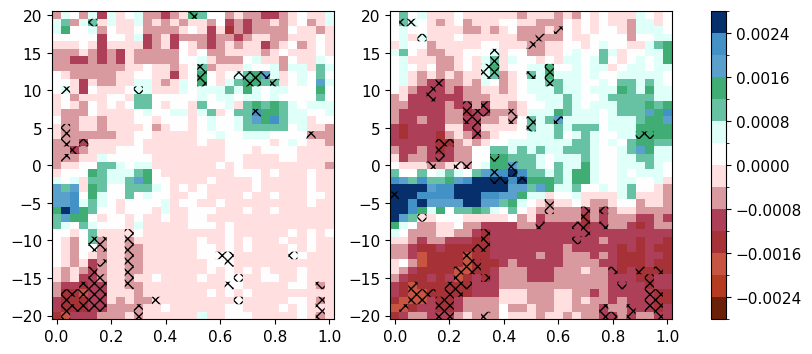

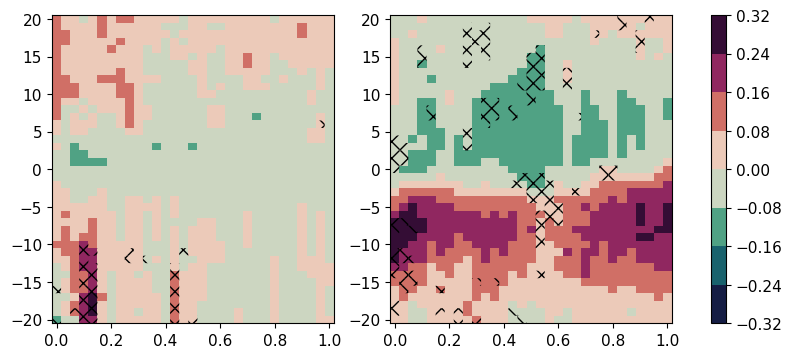

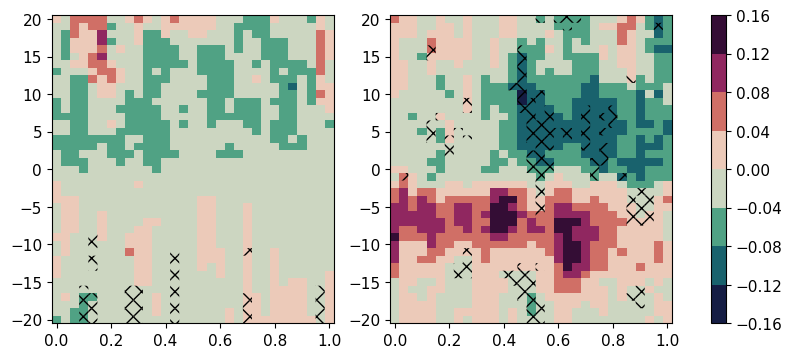

In [13]:
spells_from_jet = spells_list_time_before["STJ lifetime"]
spells_from_jet = subset_around_onset(spells_from_jet, around_onset=datetime.timedelta(days=1))
jets = all_jets_one_df.filter(pl.col("time").dt.hour() == 0, pl.col("time").dt.month().is_in([6, 7, 8]))
spells_from_jet = spells_from_jet.filter(pl.col("time").dt.month().is_in([6, 7, 8]))

plot_all_relative_composites(jets, spells_from_jet, variable_dict, 50)

[<Figure size 1000x400 with 3 Axes>,
 <Figure size 1000x400 with 3 Axes>,
 <Figure size 1000x400 with 3 Axes>,
 <Figure size 1000x400 with 3 Axes>]

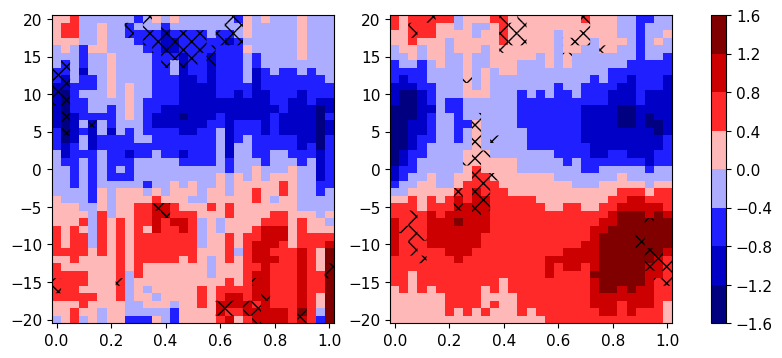

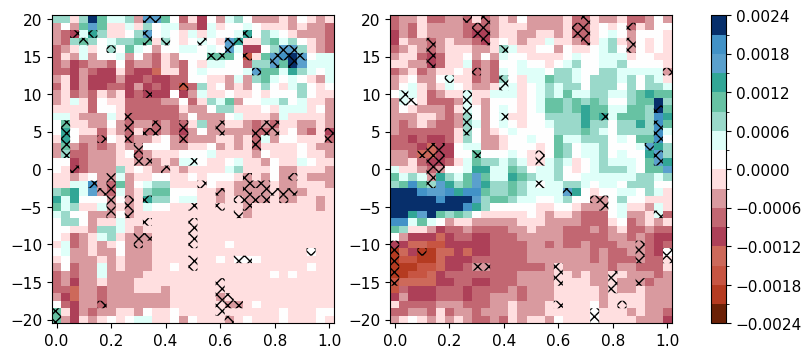

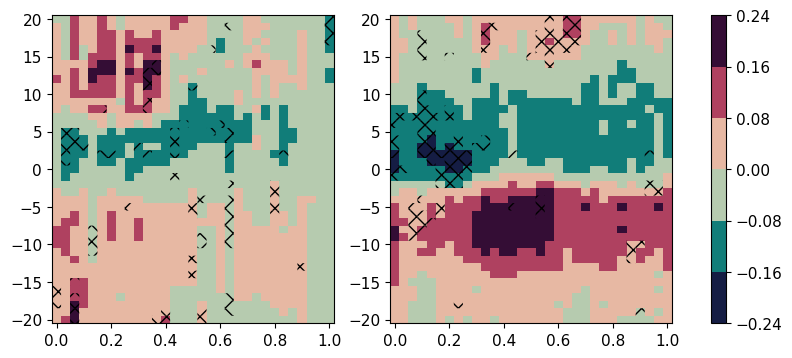

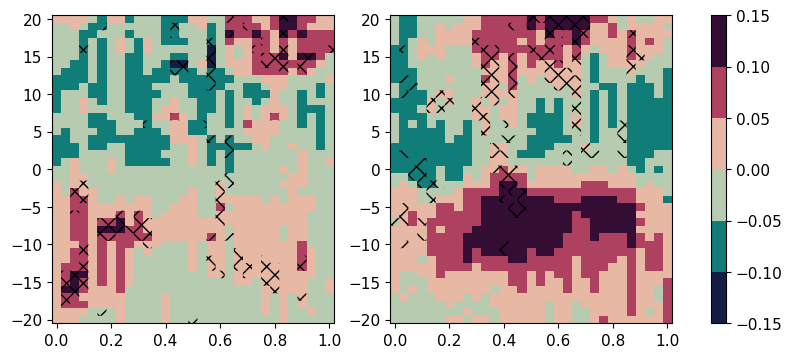

In [14]:
spells_from_jet = spells_list_time_before["EDJ com spe"]
spells_from_jet = subset_around_onset(spells_from_jet, around_onset=datetime.timedelta(days=1))
jets = all_jets_one_df.filter(pl.col("time").dt.hour() == 0, pl.col("time").dt.month().is_in([6, 7, 8]))
spells_from_jet = spells_from_jet.filter(pl.col("time").dt.month().is_in([6, 7, 8]))

plot_all_relative_composites(jets, spells_from_jet, variable_dict, 50)

[<Figure size 1000x400 with 3 Axes>,
 <Figure size 1000x400 with 3 Axes>,
 <Figure size 1000x400 with 3 Axes>,
 <Figure size 1000x400 with 3 Axes>]

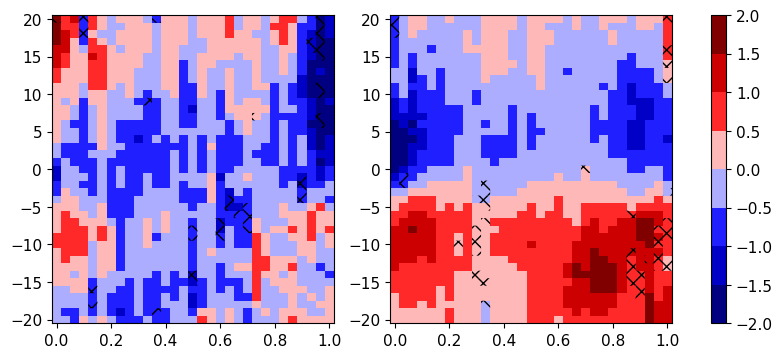

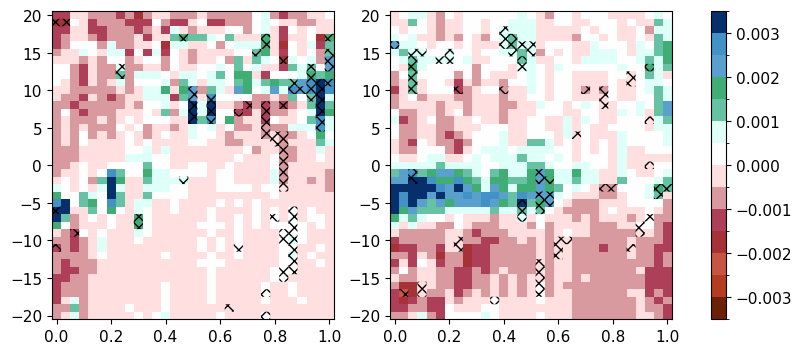

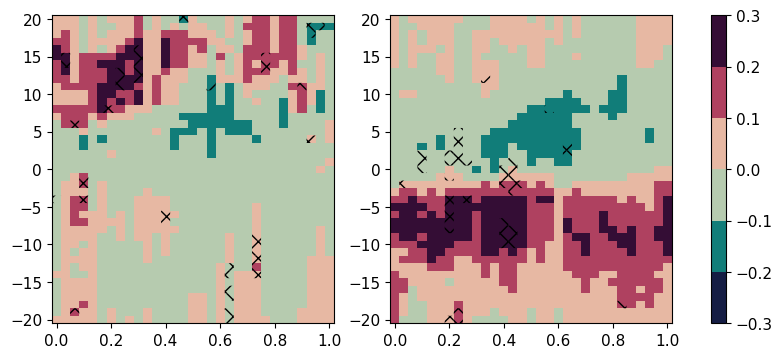

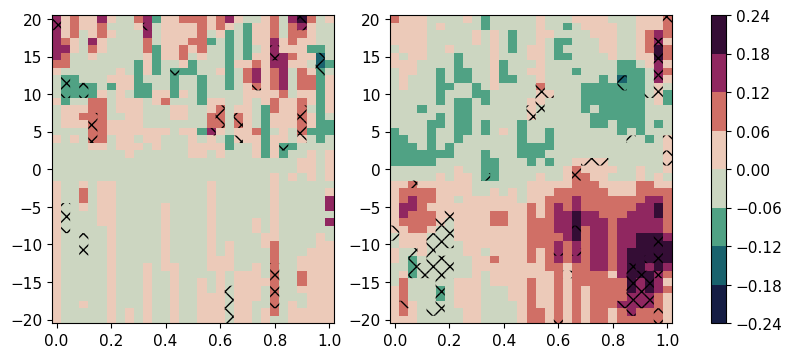

In [15]:
spells_from_jet = spells_list_time_before["STJ com spe"]
spells_from_jet = subset_around_onset(spells_from_jet, around_onset=datetime.timedelta(days=1))
jets = all_jets_one_df.filter(pl.col("time").dt.hour() == 0, pl.col("time").dt.month().is_in([6, 7, 8]))
spells_from_jet = spells_from_jet.filter(pl.col("time").dt.month().is_in([6, 7, 8]))

plot_all_relative_composites(jets, spells_from_jet, variable_dict, 50)

## jet coordinate time series: hovmoller time x normal, one for each half of the jet...

In [16]:
jets = all_jets_one_df.filter(pl.col("time").dt.hour() == 0, pl.col("time").dt.month().is_in([6, 7, 8]))

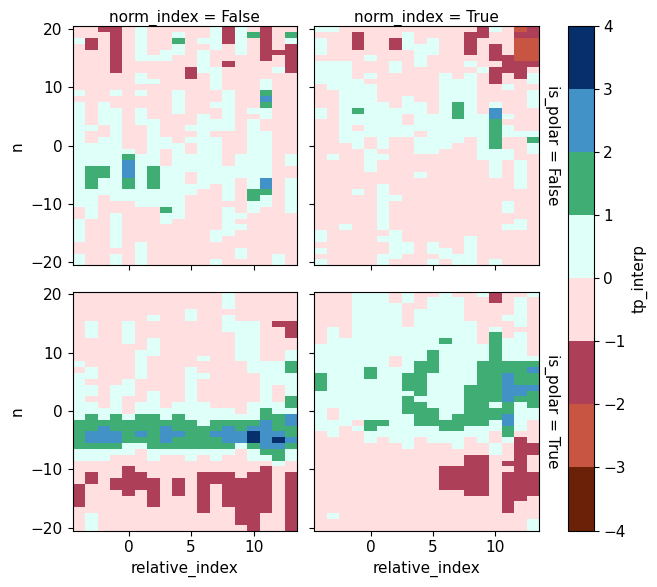

In [17]:
spells_from_jet = spells_list_time_before["EDJ lifetime"]
spells_from_jet = spells_from_jet.filter(pl.col("time").dt.month().is_in([6, 7, 8]))
jets_with_interp = _gather_normal_da_jets_wrapper(jets, spells_from_jet, da_tp)
tentative = jets_with_interp.group_by(pl.col("is_polar") > 0.5, "relative_index", "relative_time", pl.col("norm_index") > 0.5, "n", maintain_order=True).agg(pl.col("tp_interp").mean())
(1000 * polars_to_xarray(tentative, index_columns=["is_polar", "norm_index", "relative_index", "n"])["tp_interp"][:, :, :18]).plot(row="is_polar", col="norm_index", x="relative_index", y="n", levels=8, cmap=colormaps.precip4_diff_19lev, extend="neither")

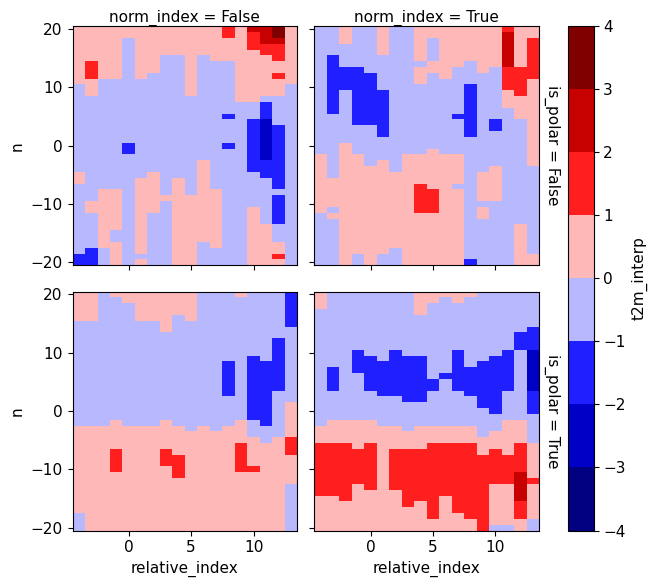

In [18]:
spells_from_jet = spells_list_time_before["EDJ lifetime"]
spells_from_jet = spells_from_jet.filter(pl.col("time").dt.month().is_in([6, 7, 8]))
jets_with_interp = _gather_normal_da_jets_wrapper(jets, spells_from_jet, da_T)
tentative = jets_with_interp.group_by(pl.col("is_polar") > 0.5, "relative_index", "relative_time", pl.col("norm_index") > 0.5, "n", maintain_order=True).agg(pl.col("t2m_interp").mean())
polars_to_xarray(tentative, index_columns=["is_polar", "norm_index", "relative_index", "n"])["t2m_interp"][:, :, :18].plot(row="is_polar", col="norm_index", x="relative_index", y="n", levels=8, cmap=colormaps.BlWhRe)

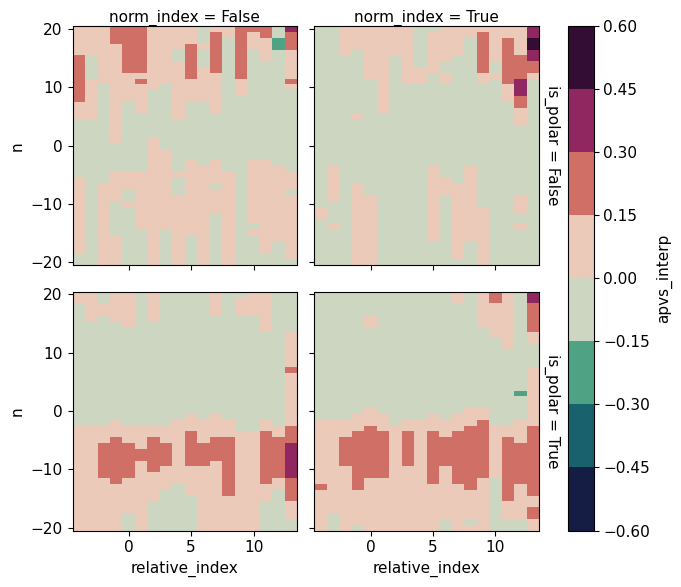

In [19]:
spells_from_jet = spells_list_time_before["EDJ lifetime"]
spells_from_jet = spells_from_jet.filter(pl.col("time").dt.month().is_in([6, 7, 8]))
jets_with_interp = _gather_normal_da_jets_wrapper(jets, spells_from_jet, da_apvs)
tentative = jets_with_interp.group_by(pl.col("is_polar") > 0.5, "relative_index", "relative_time", pl.col("norm_index") > 0.5, "n", maintain_order=True).agg(pl.col("apvs_interp").mean())
polars_to_xarray(tentative, index_columns=["is_polar", "norm_index", "relative_index", "n"])["apvs_interp"][:, :, :18].plot(row="is_polar", col="norm_index", x="relative_index", y="n", levels=8, cmap=colormaps.curl)

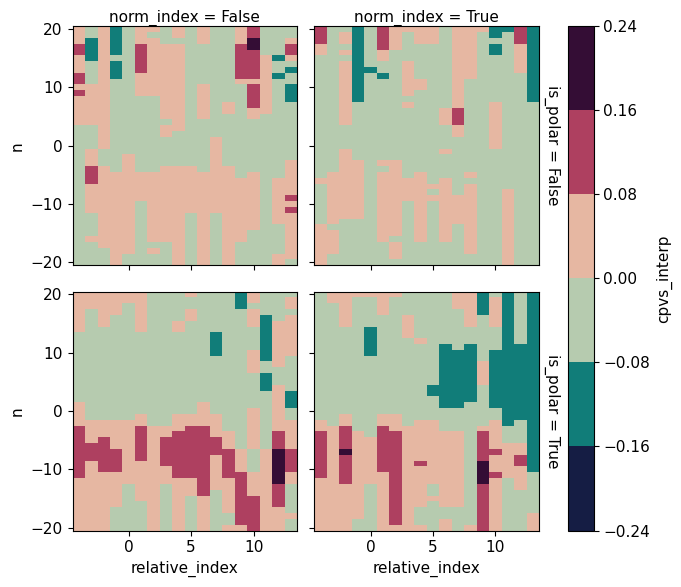

In [20]:
spells_from_jet = spells_list_time_before["EDJ lifetime"]
spells_from_jet = spells_from_jet.filter(pl.col("time").dt.month().is_in([6, 7, 8]))
jets_with_interp = _gather_normal_da_jets_wrapper(jets, spells_from_jet, da_cpvs)
tentative = jets_with_interp.group_by(pl.col("is_polar") > 0.5, "relative_index", "relative_time", pl.col("norm_index") > 0.5, "n", maintain_order=True).agg(pl.col("cpvs_interp").mean())
polars_to_xarray(tentative, index_columns=["is_polar", "norm_index", "relative_index", "n"])["cpvs_interp"][:, :, :18].plot(row="is_polar", col="norm_index", x="relative_index", y="n", levels=8, cmap=colormaps.curl)

# case studies

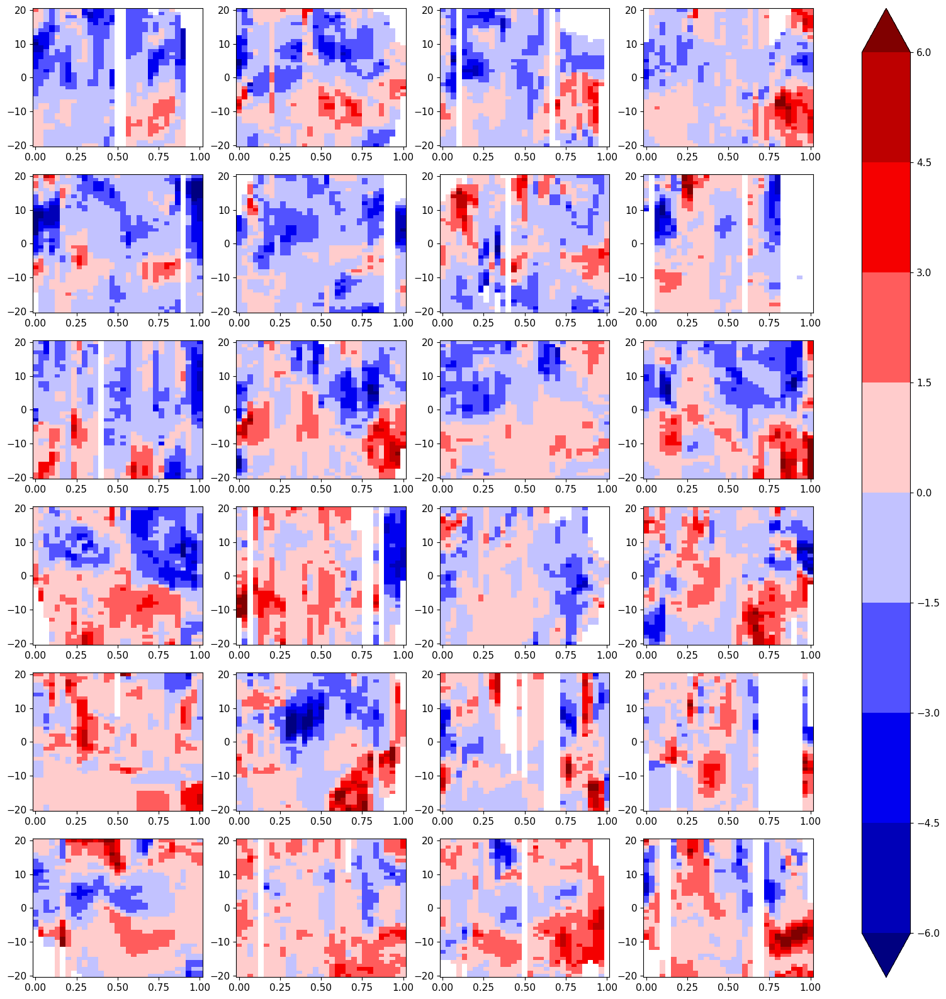

In [21]:
spells_onset = spells_list_time_before["EDJ lifetime"]
spells_onset = subset_around_onset(spells_onset, 0)
jets = all_jets_one_df.filter(pl.col("time").dt.hour() == 0, pl.col("time").dt.month().is_in([6, 7, 8]))
da = da_T

jets = _gather_normal_da_jets_wrapper(jets, spells_onset, da)
varname = da.name + "_interp"
jets = jets.group_by([pl.col("is_polar") > 0.5, "norm_index", "n", "spell"], maintain_order=True).agg(pl.col(varname).mean())
jets = polars_to_xarray(jets, ["is_polar", "norm_index", "n", "spell"])
fig, axes = plt.subplots(6, 4, figsize=(20, 20))
axes = axes.flatten()
cmap = colormaps.BlWhRe
norm = BoundaryNorm(MaxNLocator(8, symmetric=True).tick_values(jets.quantile(0.01), jets.quantile(0.99)), cmap.N, extend="both")
for i, ax in zip(range(jets["spell"].max().item() + 1), axes):
    ax.pcolormesh(jets.norm_index, jets.n, jets[1, :, :, i].T, cmap=cmap, norm=norm)
fig.colorbar(ScalarMappable(norm, cmap), ax=axes)

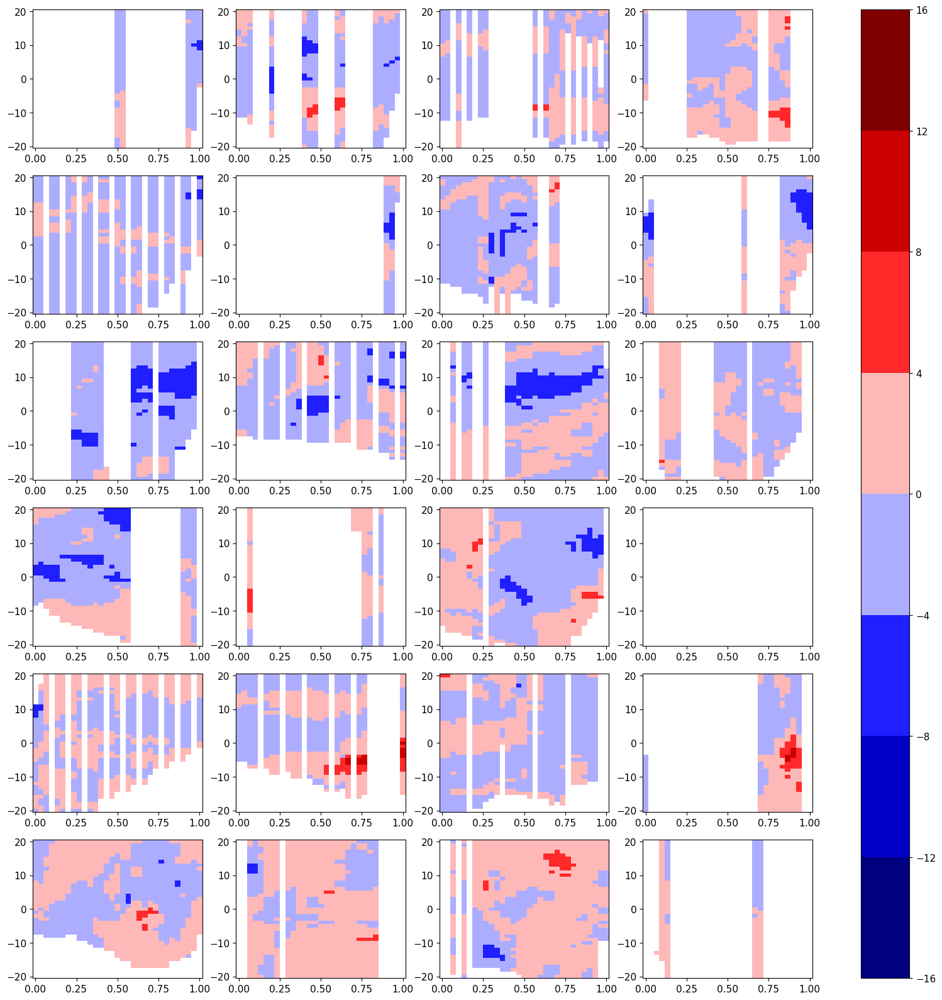

In [22]:
spells_onset = spells_list_time_before["EDJ lifetime"]
spells_onset = subset_around_onset(spells_onset, 0)
jets = all_jets_one_df.filter(pl.col("time").dt.hour() == 0, pl.col("time").dt.month().is_in([6, 7, 8]))
da = da_T

jets = _gather_normal_da_jets_wrapper(jets, spells_onset, da)
varname = da.name + "_interp"
jets = jets.group_by([pl.col("is_polar") > 0.5, "norm_index", "n", "spell"], maintain_order=True).agg(pl.col(varname).mean())
jets = polars_to_xarray(jets, ["is_polar", "norm_index", "n", "spell"])
fig, axes = plt.subplots(6, 4, figsize=(20, 20))
axes = axes.flatten()
cmap = colormaps.BlWhRe
norm = BoundaryNorm(MaxNLocator(8, symmetric=True).tick_values(jets.min(), jets.max()), cmap.N)
for i, ax in zip(range(jets["spell"].max().item() + 1), axes):
    ax.pcolormesh(jets.norm_index, jets.n, jets[0, :, :, i].T, cmap=cmap, norm=norm)
fig.colorbar(ScalarMappable(norm, cmap), ax=axes)

In [25]:
t_to_plot

<xarray.Dataset> Size: 13MB
Dimensions:         (spell: 25, lat: 131, lon: 241)
Coordinates:
    len             (spell) uint32 100B 9 8 8 8 9 9 14 17 ... 13 10 9 10 8 8 8
    time            (spell) datetime64[ns] 200B 1964-08-18 ... 2022-06-13
    relative_time   timedelta64[ns] 8B 00:00:00
    value           (spell) bool 25B True True True True ... True True True True
  * spell           (spell) uint32 100B 0 1 2 3 4 5 6 7 ... 18 19 20 21 22 23 24
    relative_index  int32 4B 0
  * lat             (lat) float32 524B 15.0 15.5 16.0 16.5 ... 79.0 79.5 80.0
  * lon             (lon) float32 964B -80.0 -79.5 -79.0 ... 39.0 39.5 40.0
Data variables:
    start           (spell, lat, lon) int64 6MB 538 538 538 ... 5808 5808 5808
    range           (spell, lat, lon) uint32 3MB 538 538 538 ... 5808 5808 5808
    t2m             (spell, lat, lon) float32 3MB -0.9837 -0.9586 ... -0.6649

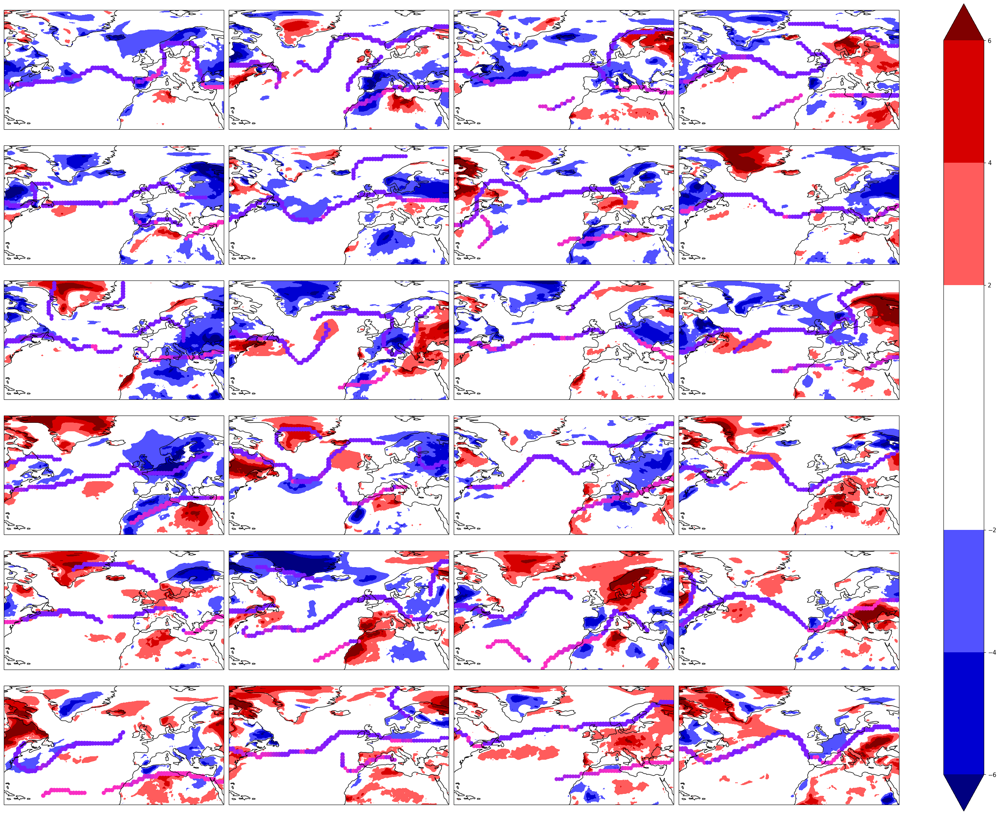

In [26]:
spells_onset = spells_list_time_before["EDJ lifetime"]
spells_onset = spells_onset.filter(pl.col("relative_index") == 0)
da = da_T

plot_kwargs = {
    "cmap": colormaps.BlWhRe,
    "levels": 7
}

clu = Clusterplot(6, 4, get_region(da_T))
t_to_plot = mask_from_spells_pl(spells_onset, da_T).sel(relative_index=0)["t2m"]
z_to_plot = mask_from_spells_pl(spells_onset, da_z).sel(relative_index=0)
n_spells = t_to_plot.spell.shape[0]
# print(n_spells)
# to_plot = to_plot
_ = clu.add_contourf(
    t_to_plot,
    **plot_kwargs
)
# _ = clu.add_contour(
#     z_to_plot,
#     levels=9,
# )
axes = clu.axes.ravel()
for i, ax in zip(range(jets["spell"].max().item() + 1), axes):
    date = spells_onset.filter(pl.col("spell") == i)["time"].first()
    jets_ = all_jets_one_df.filter(pl.col("time") == date)
    for _, jet in jets_.group_by("jet ID"):
        lo, la, is_p, s = jet[["lon", "lat", "is_polar", "s"]].to_numpy().T
        ax.scatter(lo, la, c=is_p, lw=2, s=s, cmap=PINKPURPLE, vmin=0, vmax=1)

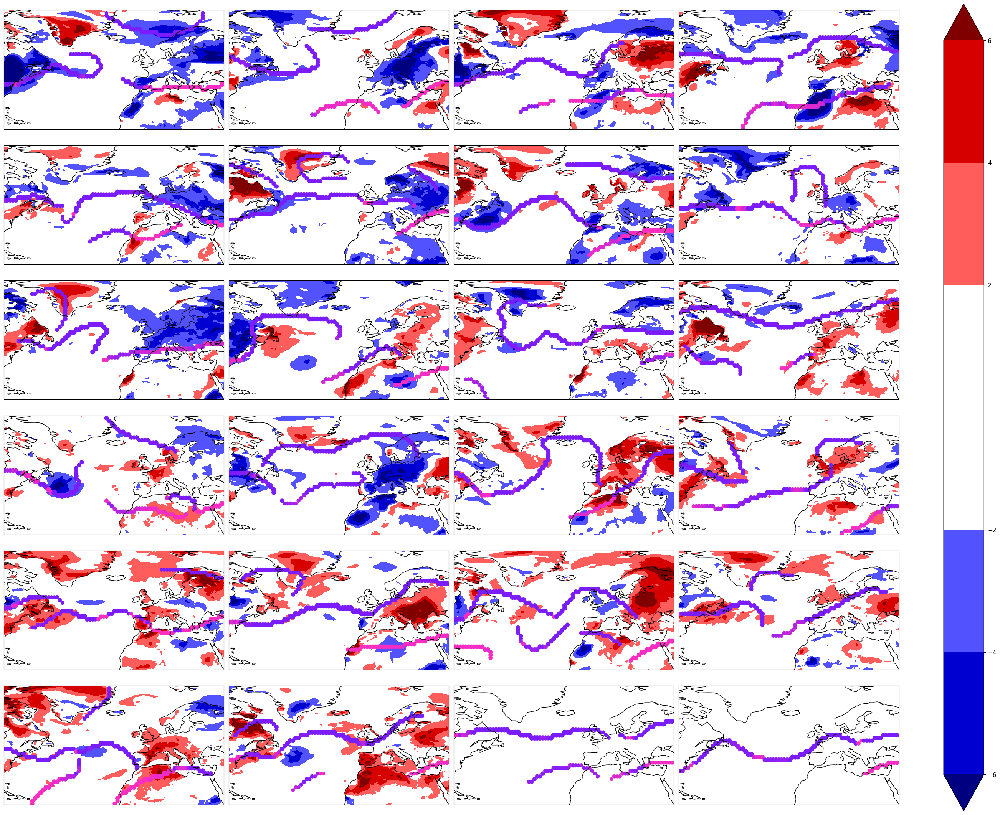

In [28]:
spells_onset = spells_list_time_before["EDJ lifetime"]
spells_onset = spells_onset.filter(pl.col("relative_index") == -4)
da = da_T

plot_kwargs = {
    "cmap": colormaps.BlWhRe,
    "levels": 7
}

clu = Clusterplot(6, 4, get_region(da_T))
t_to_plot = mask_from_spells_pl(spells_onset, da_T).sel(relative_index=0)["t2m"]
z_to_plot = mask_from_spells_pl(spells_onset, da_z).sel(relative_index=0)
n_spells = t_to_plot.spell.shape[0]
# print(n_spells)
# to_plot = to_plot
_ = clu.add_contourf(
    t_to_plot,
    **plot_kwargs
)
# _ = clu.add_contour(
#     z_to_plot,
#     levels=9,
# )
axes = clu.axes.ravel()
for i, ax in zip(range(jets["spell"].max().item() + 1), axes):
    date = spells_onset.filter(pl.col("spell") == i)["time"].first()
    jets_ = all_jets_one_df.filter(pl.col("time") == date)
    for _, jet in jets_.group_by("jet ID"):
        lo, la, is_p, s = jet[["lon", "lat", "is_polar", "s"]].to_numpy().T
        ax.scatter(lo, la, c=is_p, lw=2, s=s, cmap=PINKPURPLE, vmin=0, vmax=1)

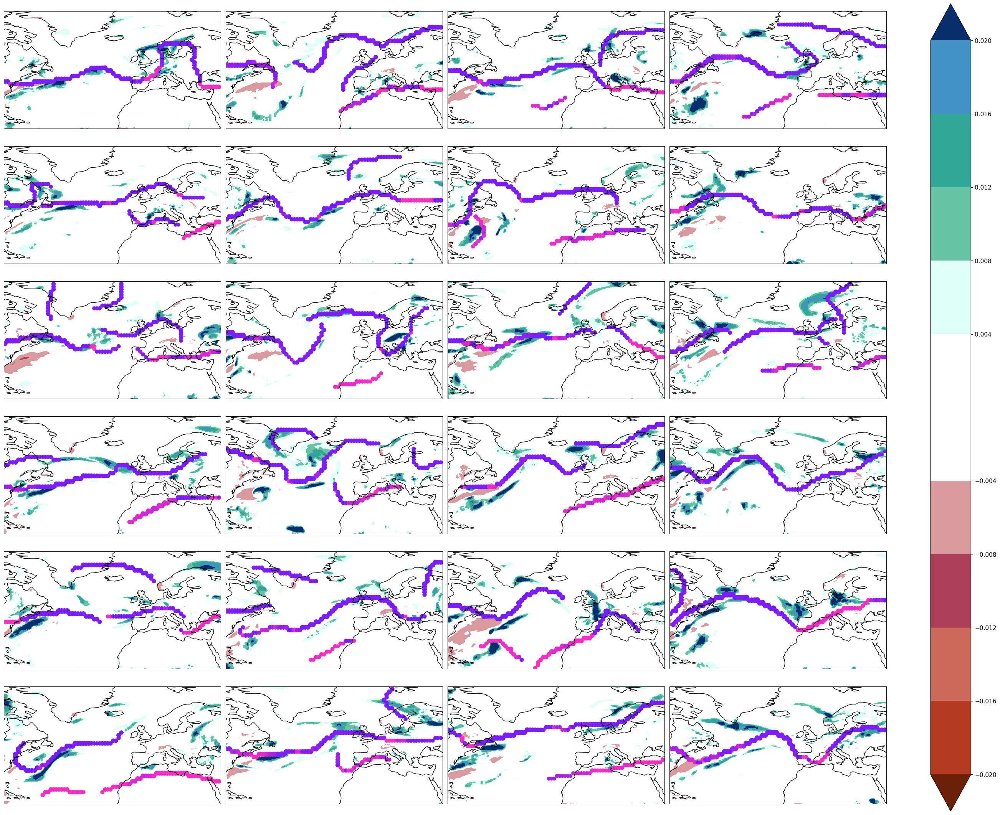

In [29]:
spells_onset = spells_list_time_before["EDJ lifetime"]
spells_onset = spells_onset.filter(pl.col("relative_index") == 0)
da = da_T

plot_kwargs = {
    "cmap": colormaps.precip4_diff_19lev,
    "levels": 11
}

clu = Clusterplot(6, 4, get_region(da_T))
t_to_plot = mask_from_spells_pl(spells_onset, da_tp).sel(relative_index=0)["tp"]
n_spells = t_to_plot.spell.shape[0]
# print(n_spells)
# to_plot = to_plot
_ = clu.add_contourf(
    t_to_plot,
    **plot_kwargs
)
axes = clu.axes.ravel()
for i, ax in zip(range(jets["spell"].max().item() + 1), axes):
    date = spells_onset.filter(pl.col("spell") == i)["time"].first()
    jets_ = all_jets_one_df.filter(pl.col("time") == date)
    for _, jet in jets_.group_by("jet ID"):
        lo, la, is_p, s = jet[["lon", "lat", "is_polar", "s"]].to_numpy().T
        ax.scatter(lo, la, c=is_p, lw=2, s=s, cmap=PINKPURPLE, vmin=0, vmax=1)

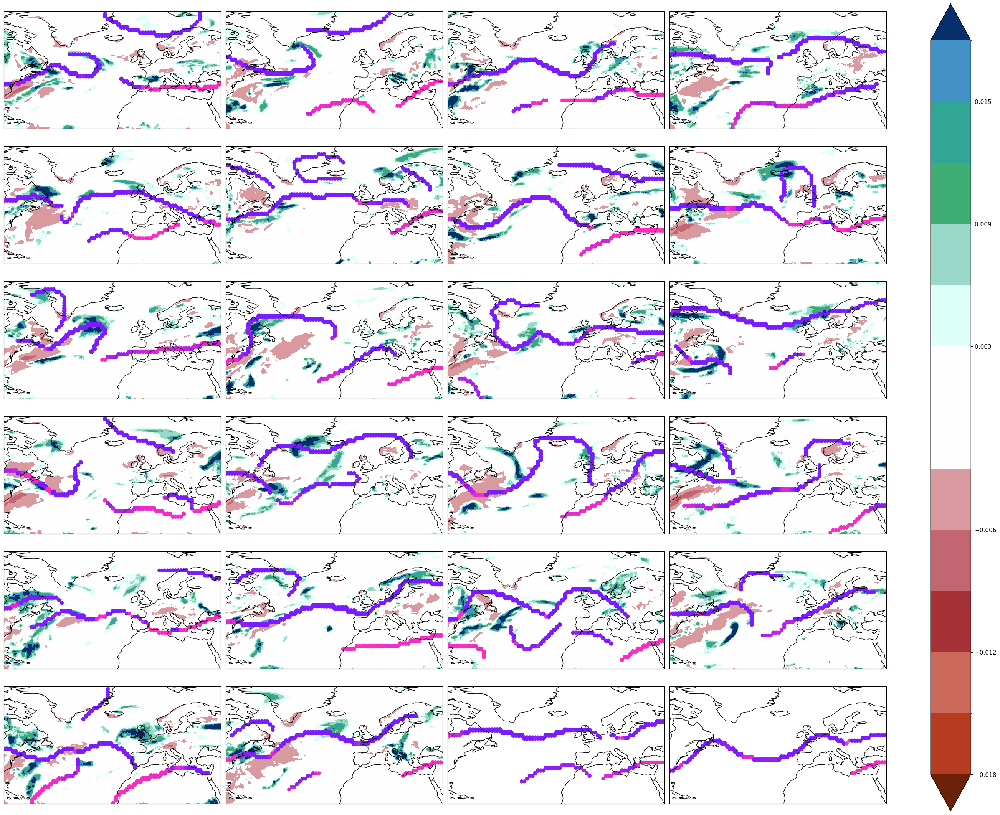

In [30]:
spells_onset = spells_list_time_before["EDJ lifetime"]
spells_onset = spells_onset.filter(pl.col("relative_index") == -4)
da = da_T

plot_kwargs = {
    "cmap": colormaps.precip4_diff_19lev,
    "levels": 11
}

clu = Clusterplot(6, 4, get_region(da_T))
t_to_plot = mask_from_spells_pl(spells_onset, da_tp).sel(relative_index=0)["tp"]
n_spells = t_to_plot.spell.shape[0]
# print(n_spells)
# to_plot = to_plot
_ = clu.add_contourf(
    t_to_plot,
    **plot_kwargs
)
# _ = clu.add_contour(
#     z_to_plot,
#     levels=9,
# )
axes = clu.axes.ravel()
for i, ax in zip(range(jets["spell"].max().item() + 1), axes):
    date = spells_onset.filter(pl.col("spell") == i)["time"].first()
    jets_ = all_jets_one_df.filter(pl.col("time") == date)
    for _, jet in jets_.group_by("jet ID"):
        lo, la, is_p, s = jet[["lon", "lat", "is_polar", "s"]].to_numpy().T
        ax.scatter(lo, la, c=is_p, lw=2, s=s, cmap=PINKPURPLE, vmin=0, vmax=1)

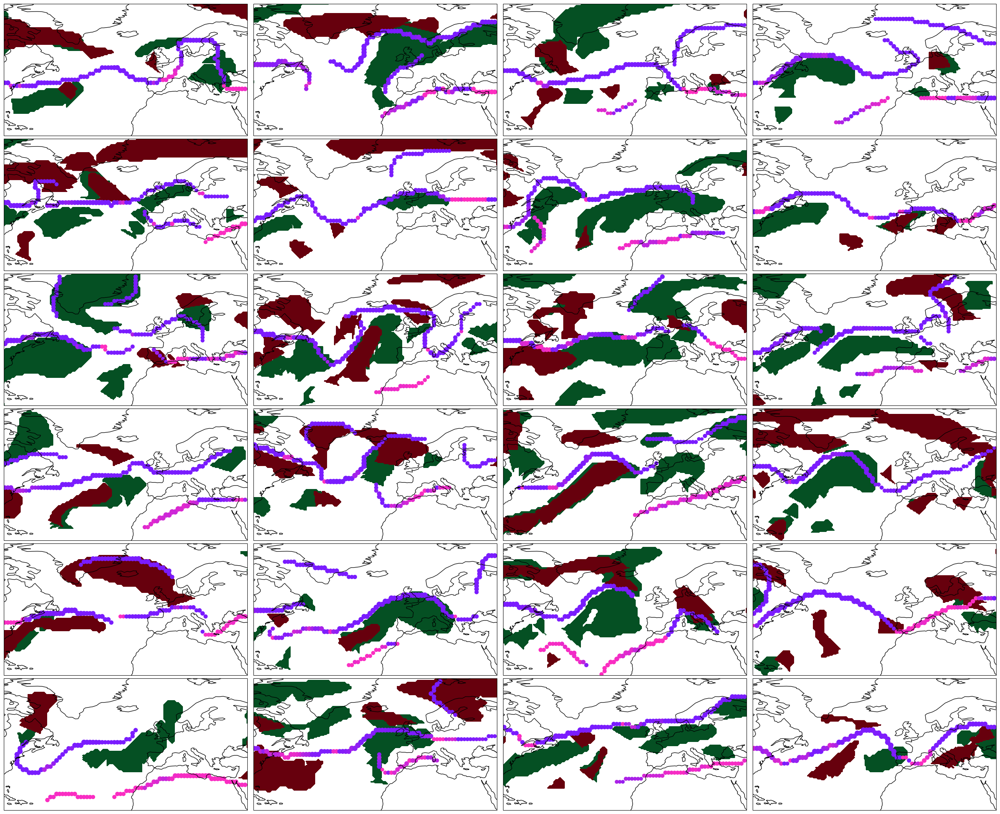

In [31]:
spells_onset = spells_list_time_before["EDJ lifetime"]
spells_onset = spells_onset.filter(pl.col("relative_index") == 0)

plot_kwargs = {
    "cmap": colormaps.WhiteGreen,
    "levels": 1,
    "transparify": 1,
    "draw_cbar": False,
}
plot_kwargs_2 = plot_kwargs | {"cmap": colormaps.reds}

clu = Clusterplot(6, 4, get_region(da_T))
to_plot_1 = mask_from_spells_pl(spells_onset, da_apvs).sel(relative_index=0)["apvs"]
to_plot_1 = to_plot_1 > 0
to_plot_2 = mask_from_spells_pl(spells_onset, da_cpvs).sel(relative_index=0)["cpvs"]
to_plot_2 = to_plot_2 > 0
n_spells = to_plot_1.spell.shape[0]
# print(n_spells)
# to_plot = to_plot
_ = clu.add_contourf(
    to_plot_1,
    **plot_kwargs
)
_ = clu.add_contourf(
    to_plot_2,
    **plot_kwargs_2
)
# _ = clu.add_contour(
#     z_to_plot,
#     levels=9,
# )
axes = clu.axes.ravel()
for i, ax in zip(range(jets["spell"].max().item() + 1), axes):
    date = spells_onset.filter(pl.col("spell") == i)["time"].first()
    jets_ = all_jets_one_df.filter(pl.col("time") == date)
    for _, jet in jets_.group_by("jet ID"):
        lo, la, is_p, s = jet[["lon", "lat", "is_polar", "s"]].to_numpy().T
        ax.scatter(lo, la, c=is_p, lw=2, s=s, cmap=PINKPURPLE, vmin=0, vmax=1)

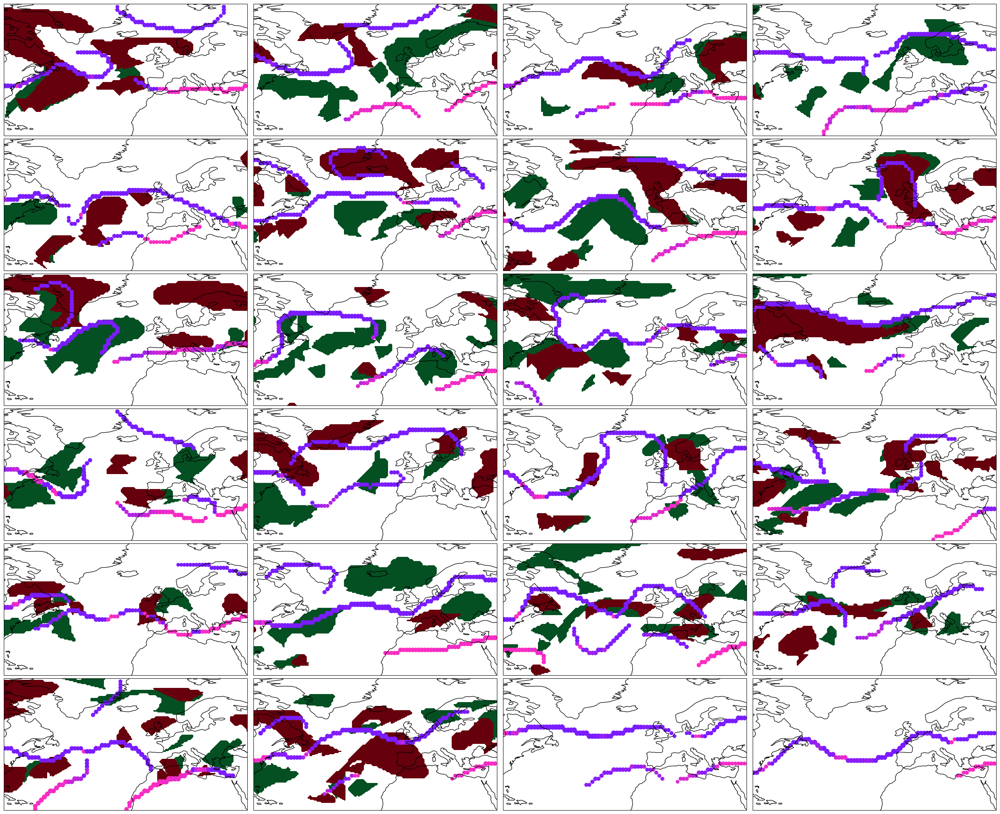

In [32]:
spells_onset = spells_list_time_before["EDJ lifetime"]
spells_onset = spells_onset.filter(pl.col("relative_index") == -4)

plot_kwargs = {
    "cmap": colormaps.WhiteGreen,
    "levels": 1,
    "transparify": 1,
    "draw_cbar": False,
}
plot_kwargs_2 = plot_kwargs | {"cmap": colormaps.reds}

clu = Clusterplot(6, 4, get_region(da_T))
to_plot_1 = mask_from_spells_pl(spells_onset, da_apvs).sel(relative_index=0)["apvs"]
to_plot_1 = to_plot_1 > 0
to_plot_2 = mask_from_spells_pl(spells_onset, da_cpvs).sel(relative_index=0)["cpvs"]
to_plot_2 = to_plot_2 > 0
n_spells = to_plot_1.spell.shape[0]
# print(n_spells)
# to_plot = to_plot
_ = clu.add_contourf(
    to_plot_1,
    **plot_kwargs
)
_ = clu.add_contourf(
    to_plot_2,
    **plot_kwargs_2
)
# _ = clu.add_contour(
#     z_to_plot,
#     levels=9,
# )
axes = clu.axes.ravel()
for i, ax in zip(range(jets["spell"].max().item() + 1), axes):
    date = spells_onset.filter(pl.col("spell") == i)["time"].first()
    jets_ = all_jets_one_df.filter(pl.col("time") == date)
    for _, jet in jets_.group_by("jet ID"):
        lo, la, is_p, s = jet[["lon", "lat", "is_polar", "s"]].to_numpy().T
        ax.scatter(lo, la, c=is_p, lw=2, s=s, cmap=PINKPURPLE, vmin=0, vmax=1)

# Relative time series

24


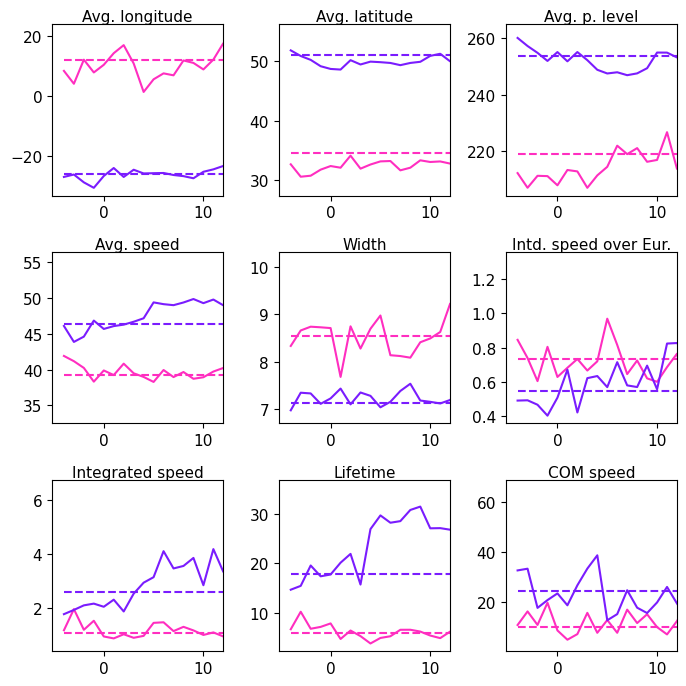

In [47]:
spells_from_jet = spells_list_time_before["EDJ lifetime"]
props_masked = mask_from_spells_pl(spells_from_jet, props_as_df, time_before=datetime.timedelta(days=4))
props_as_df_summer = props_as_df.filter(pl.col("time").dt.month().is_in([6, 7, 8]))
data_vars = ["mean_lon", "mean_lat", "mean_lev", "mean_s", "width", "int_over_europe", "int", "persistence", "com_speed"]
aggs = {col: pl.col(col).mean() for col in data_vars}
aggs = aggs | {"alive": pl.col("time").len()}
mean_ps = props_masked.group_by(["relative_index", "jet"], maintain_order=True).agg(**aggs)
fig, axes = plt.subplots(3, 3, figsize=(7, 7))
axes = axes.ravel()
x = mean_ps["relative_index"].unique().to_numpy()
means = props_as_df_summer.group_by("jet", maintain_order=True).mean()
for j, jet in enumerate(["STJ", "EDJ"]):
    to_plot = mean_ps.filter(pl.col("jet") == jet)
    for ax, data_var in zip(axes, data_vars):
        factor = 1e9 if data_var in ["int_over_europe", "int"] else 1
        factor = 1e5 if data_var == "width" else factor
        ax.plot(x, to_plot[data_var] / factor, color=COLORS[2 - j])
        mean = means[j, data_var] / factor
        ax.plot([x[0], x[-1]], [mean, mean], color=COLORS[2 - j], ls="dashed")
        if j == 0:
            ax.set_title(PRETTIER_VARNAME[data_var])
for ax in axes:
    ax.set_xlim([ax.get_xlim()[0], 12])
print(props_masked["spell"].max())
fig.set_tight_layout(True)
fig.savefig(f"{FIGURES}/persistent_spells/props_edj_persistence.png")

24


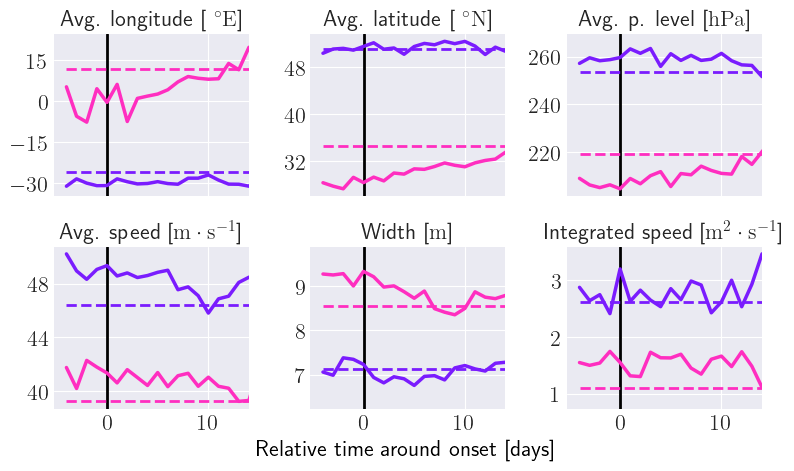

In [51]:
plt.style.use('seaborn-v0_8-darkgrid')
plt.rc("xtick", labelsize=16)
plt.rc("ytick", labelsize=16)
plt.rc("axes", labelsize=16)
plt.rc("axes", titlesize=16)
plt.rc("font", size=16)
plt.rc("text", usetex=True)
plt.rc("savefig", dpi=300)

spells_from_jet = spells_list_time_before["STJ lifetime"]
props_masked = mask_from_spells_pl(spells_from_jet, props_as_df, time_before=datetime.timedelta(days=4))
props_as_df_summer = props_as_df.filter(pl.col("time").dt.month().is_in([6, 7, 8]))
data_vars = ["mean_lon", "mean_lat", "mean_lev", "mean_s", "width", "int"]
aggs = {col: pl.col(col).mean() for col in data_vars}
aggs = aggs | {"alive": pl.col("time").len()}
mean_ps = props_masked.group_by(["relative_index", "jet"], maintain_order=True).agg(**aggs)
fig, axes = plt.subplots(2, 3, figsize=(8, 5), sharex="all", tight_layout=False)
axes = axes.ravel()
x = mean_ps["relative_index"].unique().to_numpy()
means = props_as_df_summer.group_by("jet", maintain_order=True).mean()
for j, jet in enumerate(["STJ", "EDJ"]):
    to_plot = mean_ps.filter(pl.col("jet") == jet)
    for ax, data_var in zip(axes, data_vars):
        factor = 1e9 if data_var in ["int_over_europe", "int"] else 1
        factor = 1e5 if data_var == "width" else factor
        ax.plot(x, to_plot[data_var] / factor, color=COLORS[2 - j], lw=2.5)
        mean = means[j, data_var] / factor
        ax.plot([x[0], x[-1]], [mean, mean], color=COLORS[2 - j], ls="dashed", lw=2)
        if j == 0:
            ax.set_title(f"{PRETTIER_VARNAME[data_var]} [{UNITS[data_var]}]")
        ax.yaxis.set_major_locator(MaxNLocator(4, integer=True))
for i, ax in enumerate(axes):
    ax.axvline(0, zorder=1, color="black", lw=2)
    ax.set_xlim([ax.get_xlim()[0], 14])
    if i == 4:
        ax.set_xlabel("Relative time around onset [days]", color="black")
print(props_masked["spell"].max())
fig.set_tight_layout(True)
fig.savefig(f"{FIGURES}/Poster_EGU25/props_stj_persistence.png")

# Relative anomaly time series

In [55]:
props_anom = compute_anomalies_pl(props_as_df, smooth_clim=7 * 4, standardize=True)

24


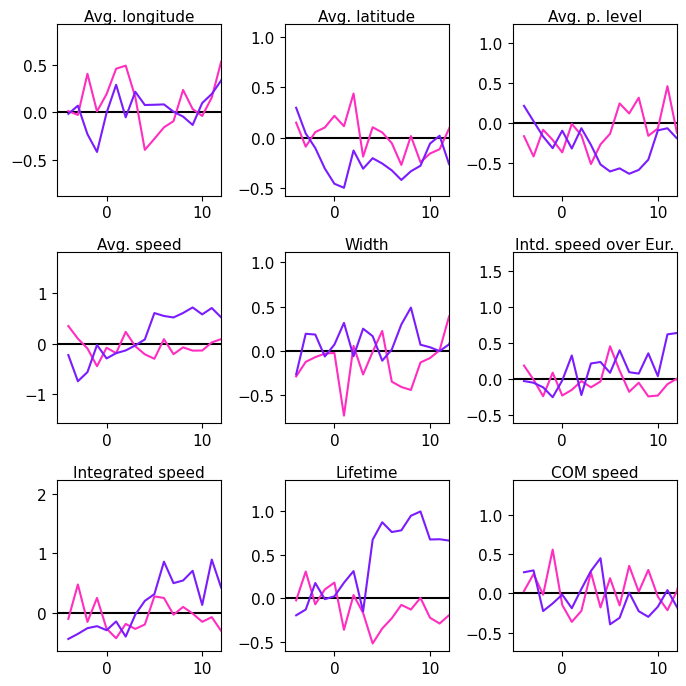

In [56]:
spells_from_jet = spells_list_time_before["EDJ lifetime"]
props_masked = mask_from_spells_pl(spells_from_jet, props_anom, time_before=datetime.timedelta(days=4))
data_vars = ["mean_lon", "mean_lat", "mean_lev", "mean_s", "width", "int_over_europe", "int", "persistence", "com_speed"]
aggs = {col: pl.col(col).mean() for col in data_vars}
aggs = aggs | {"alive": pl.col("time").len()}
mean_ps = props_masked.group_by(["relative_index", "jet"], maintain_order=True).agg(**aggs)
fig, axes = plt.subplots(3, 3, figsize=(7, 7), tight_layout=True)
axes = axes.ravel()
x = mean_ps["relative_index"].unique().to_numpy()
for j, jet in enumerate(["STJ", "EDJ"]):
    to_plot = mean_ps.filter(pl.col("jet") == jet)
    for ax, data_var in zip(axes, data_vars):
        ax.plot(x, to_plot[data_var], color=COLORS[2 - j])
        if j == 0:
            ax.set_title(PRETTIER_VARNAME[data_var])
for ax in axes:
    xlim = ax.get_xlim()
    ax.plot(xlim, [0, 0], color="black", zorder=-1)
    ax.set_xlim([xlim[0], 12])
print(props_masked["spell"].max())
fig.savefig(f"{FIGURES}/persistent_spells/props_anom_edj_persistence.png")

24


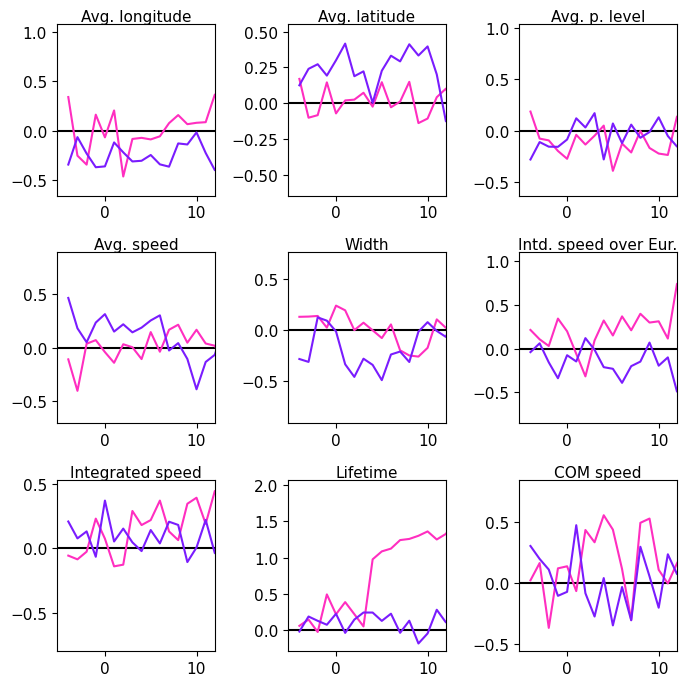

In [58]:
spells_from_jet = spells_list_time_before["STJ lifetime"]
props_masked = mask_from_spells_pl(spells_from_jet, props_anom, time_before=datetime.timedelta(days=4))
data_vars = ["mean_lon", "mean_lat", "mean_lev", "mean_s", "width", "int_over_europe", "int", "persistence", "com_speed"]
aggs = {col: pl.col(col).mean() for col in data_vars}
aggs = aggs | {"alive": pl.col("time").len()}
mean_ps = props_masked.group_by(["relative_index", "jet"], maintain_order=True).agg(**aggs)
fig, axes = plt.subplots(3, 3, figsize=(7, 7), tight_layout=True)
axes = axes.ravel()
x = mean_ps["relative_index"].unique().to_numpy()
for j, jet in enumerate(["STJ", "EDJ"]):
    to_plot = mean_ps.filter(pl.col("jet") == jet)
    for ax, data_var in zip(axes, data_vars):
        ax.plot(x, to_plot[data_var], color=COLORS[2 - j])
        if j == 0:
            ax.set_title(PRETTIER_VARNAME[data_var])
for ax in axes:
    xlim = ax.get_xlim()
    ax.plot(xlim, [0, 0], color="black", zorder=-1)
    ax.set_xlim([xlim[0], 12])
print(props_masked["spell"].max())
fig.savefig(f"{FIGURES}/persistent_spells/props_anom_stj_persistence.png")

22


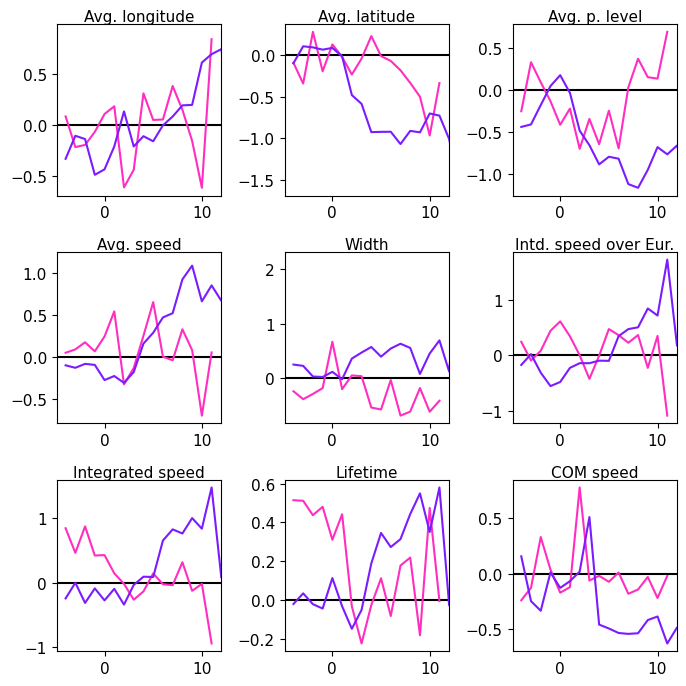

In [59]:
spells_from_jet = spells_list_time_before["EDJ com spe"]
props_masked = mask_from_spells_pl(spells_from_jet, props_anom, time_before=datetime.timedelta(days=4))
data_vars = ["mean_lon", "mean_lat", "mean_lev", "mean_s", "width", "int_over_europe", "int", "persistence", "com_speed"]
aggs = {col: pl.col(col).mean() for col in data_vars}
aggs = aggs | {"alive": pl.col("time").len()}
mean_ps = props_masked.group_by(["relative_index", "jet"], maintain_order=True).agg(**aggs)
fig, axes = plt.subplots(3, 3, figsize=(7, 7), tight_layout=True)
axes = axes.ravel()
x = mean_ps["relative_index"].unique().to_numpy()
for j, jet in enumerate(["STJ", "EDJ"]):
    to_plot = mean_ps.filter(pl.col("jet") == jet)
    for ax, data_var in zip(axes, data_vars):
        ax.plot(x, to_plot[data_var], color=COLORS[2 - j])
        if j == 0:
            ax.set_title(PRETTIER_VARNAME[data_var])
for ax in axes:
    xlim = ax.get_xlim()
    ax.plot(xlim, [0, 0], color="black", zorder=-1)
    ax.set_xlim([xlim[0], 12])
print(props_masked["spell"].max())
fig.savefig(f"{FIGURES}/persistent_spells/props_anom_edj_cs.png")

12


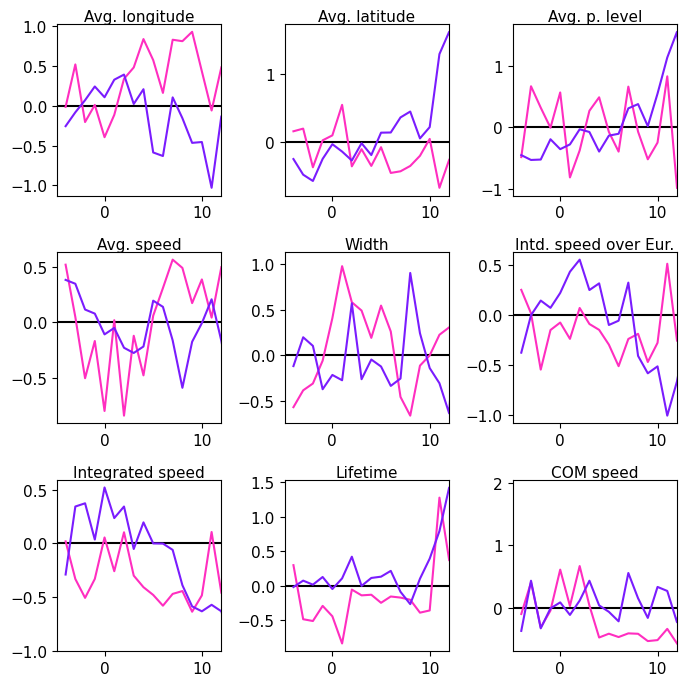

In [60]:
spells_from_jet = spells_list_time_before["STJ com spe"]
props_masked = mask_from_spells_pl(spells_from_jet, props_anom, time_before=datetime.timedelta(days=4))
data_vars = ["mean_lon", "mean_lat", "mean_lev", "mean_s", "width", "int_over_europe", "int", "persistence", "com_speed"]
aggs = {col: pl.col(col).mean() for col in data_vars}
aggs = aggs | {"alive": pl.col("time").len()}
mean_ps = props_masked.group_by(["relative_index", "jet"], maintain_order=True).agg(**aggs)
fig, axes = plt.subplots(3, 3, figsize=(7, 7), tight_layout=True)
axes = axes.ravel()
x = mean_ps["relative_index"].unique().to_numpy()
for j, jet in enumerate(["STJ", "EDJ"]):
    to_plot = mean_ps.filter(pl.col("jet") == jet)
    for ax, data_var in zip(axes, data_vars):
        ax.plot(x, to_plot[data_var], color=COLORS[2 - j])
        if j == 0:
            ax.set_title(PRETTIER_VARNAME[data_var])
for ax in axes:
    xlim = ax.get_xlim()
    ax.plot(xlim, [0, 0], color="black", zorder=-1)
    ax.set_xlim([xlim[0], 12])
print(props_masked["spell"].max())
fig.savefig(f"{FIGURES}/persistent_spells/props_anom_stj_cs.png")

# Relative time composites

25
25


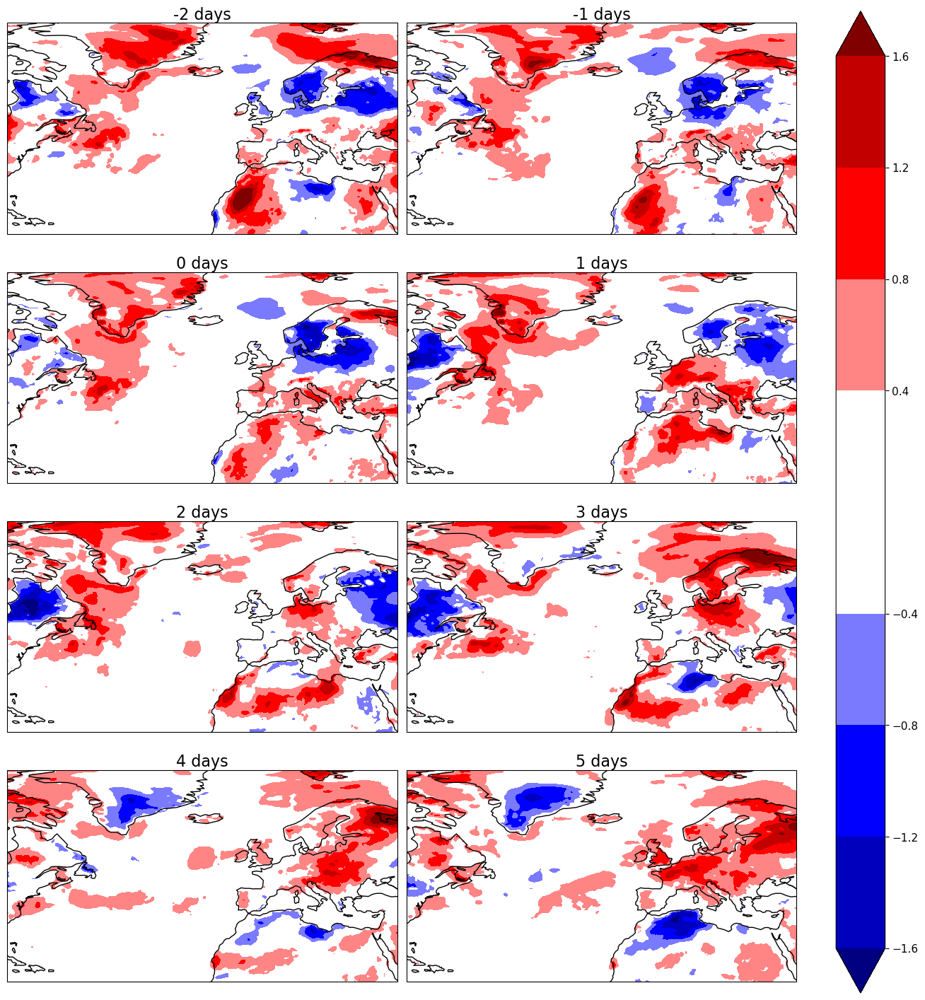

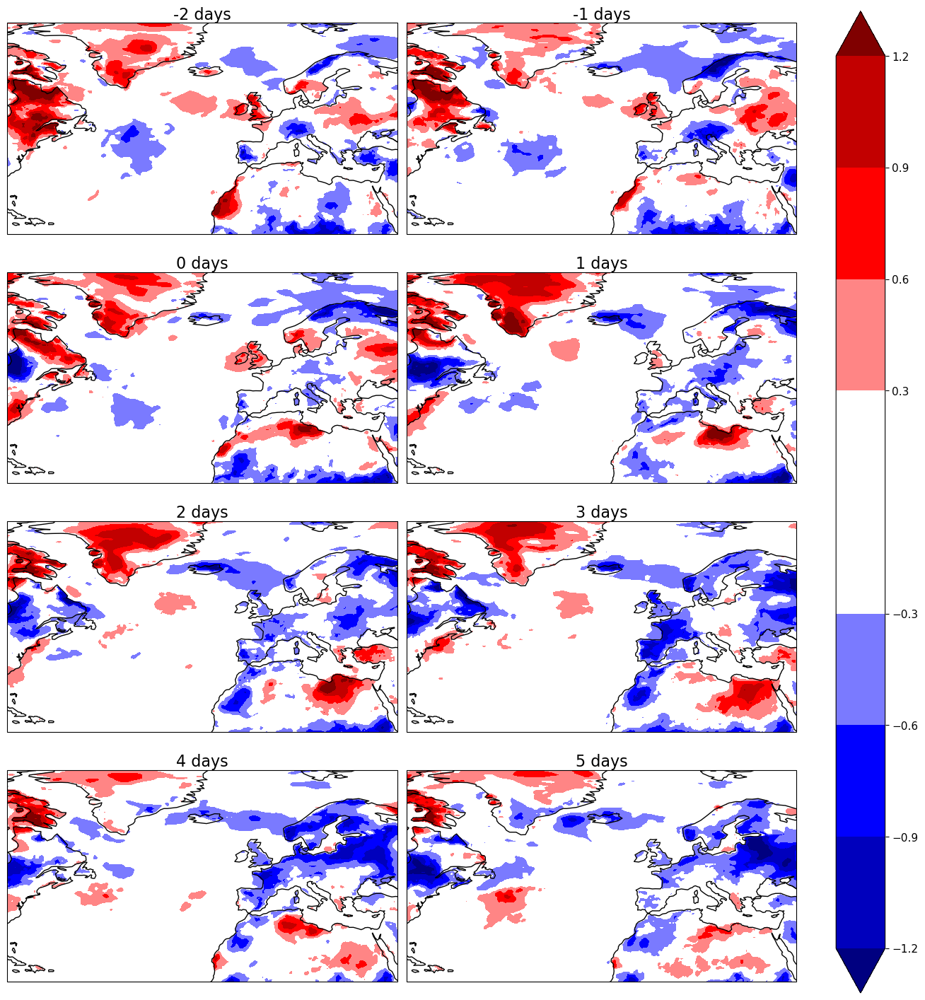

In [45]:
da = da_T.copy()
da = compute(da.sel(time=da.time.dt.season == "JJA"))
plot_kwargs = {
    "cmap": colormaps.BlWhRe,
    "levels": 7
}

clu = Clusterplot(4, 2, get_region(da))
spells_from_jet_daily = spells_list_time_before["STJ lifetime"]
to_plot = mask_from_spells_pl(spells_from_jet_daily, da, time_before=datetime.timedelta(days=4))
n_spells = to_plot.spell.shape[0]
print(n_spells)
to_plot = to_plot.mean("spell").sel(relative_index=[-2, -1, 0, 1, 2, 3, 4, 5])["t2m"]
_ = clu.add_contourf(
    to_plot,
    titles=to_plot.relative_time.values.astype("timedelta64[D]"),
    **plot_kwargs
)

clu = Clusterplot(4, 2, get_region(da))
spells_from_jet_daily = spells_list_time_before["EDJ lifetime"]
to_plot = mask_from_spells_pl(spells_from_jet_daily, da, time_before=datetime.timedelta(days=4))
n_spells = to_plot.spell.shape[0]
print(n_spells)
to_plot = to_plot.mean("spell").sel(relative_index=[-2, -1, 0, 1, 2, 3, 4, 5])["t2m"]
_ = clu.add_contourf(
    to_plot,
    titles=to_plot.relative_time.values.astype("timedelta64[D]"),
    **plot_kwargs
)

25
25


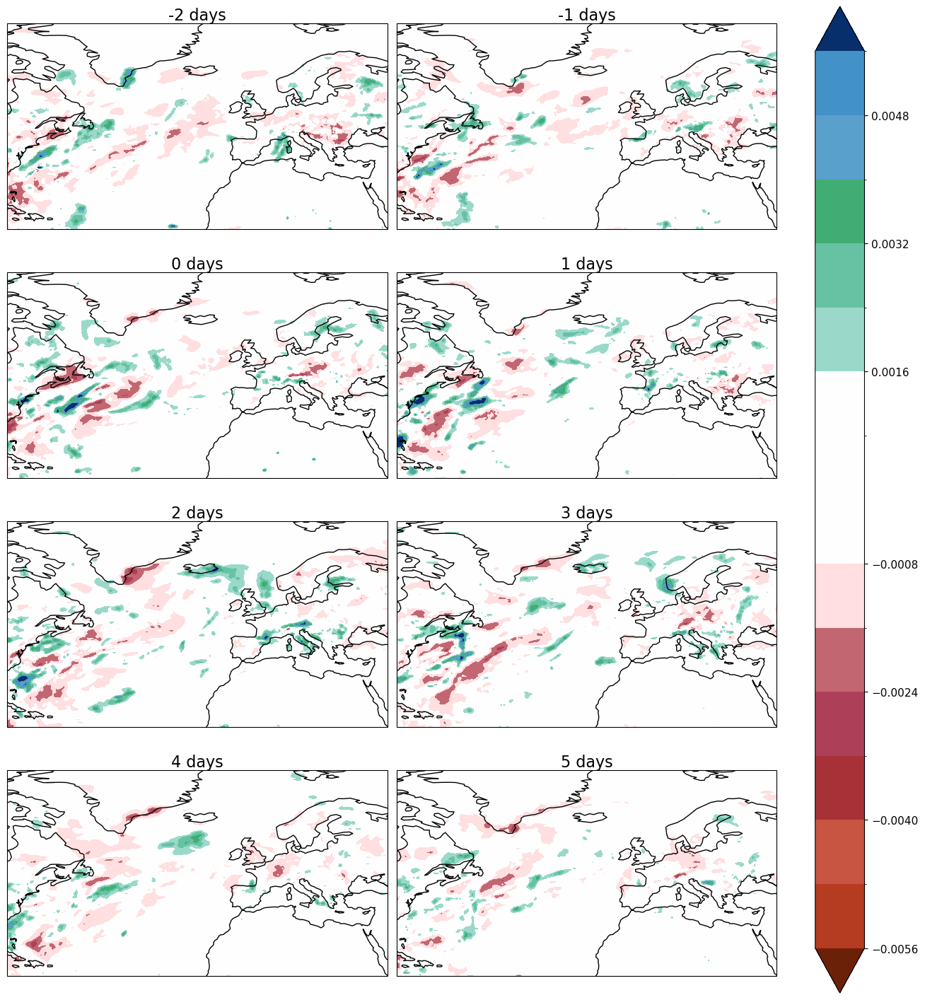

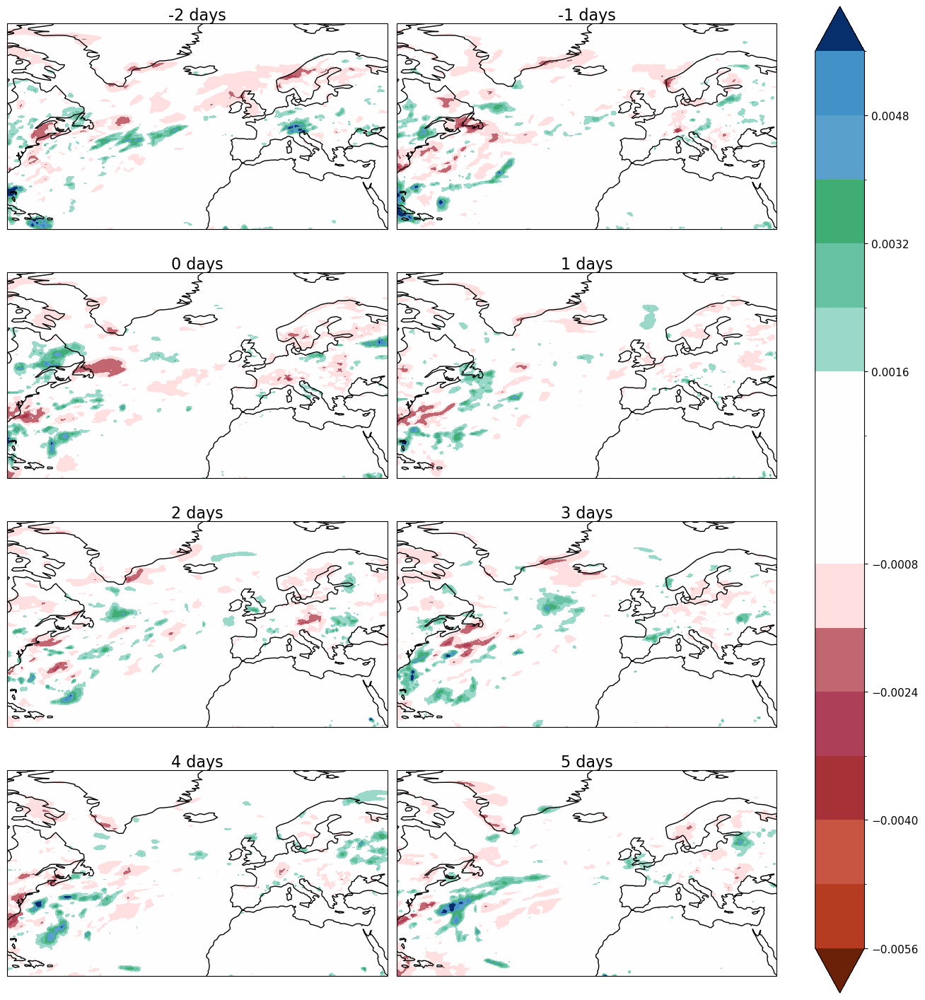

In [46]:
da = da_tp.copy()
da = compute(da.sel(time=da.time.dt.season == "JJA"))
plot_kwargs = {
    "cmap": colormaps.precip4_diff_19lev,
    "levels": 13,
    "q": 0.999,
    "transparify": 0,
}

clu = Clusterplot(4, 2, get_region(da))
spells_from_jet_daily = spells_list_time_before["STJ lifetime"]
to_plot = mask_from_spells_pl(spells_from_jet_daily, da, time_before=datetime.timedelta(days=4))
n_spells = to_plot.spell.shape[0]
print(n_spells)
to_plot = to_plot.mean("spell").sel(relative_index=[-2, -1, 0, 1, 2, 3, 4, 5])["tp"]
_ = clu.add_contourf(
    to_plot,
    titles=to_plot.relative_time.values.astype("timedelta64[D]"),
    **plot_kwargs
)

clu = Clusterplot(4, 2, get_region(da))
spells_from_jet_daily = spells_list_time_before["EDJ lifetime"]
to_plot = mask_from_spells_pl(spells_from_jet_daily, da, time_before=datetime.timedelta(days=4))
n_spells = to_plot.spell.shape[0]
print(n_spells)
to_plot = to_plot.mean("spell").sel(relative_index=[-2, -1, 0, 1, 2, 3, 4, 5])["tp"]
_ = clu.add_contourf(
    to_plot,
    titles=to_plot.relative_time.values.astype("timedelta64[D]"),
    **plot_kwargs
)

23
24


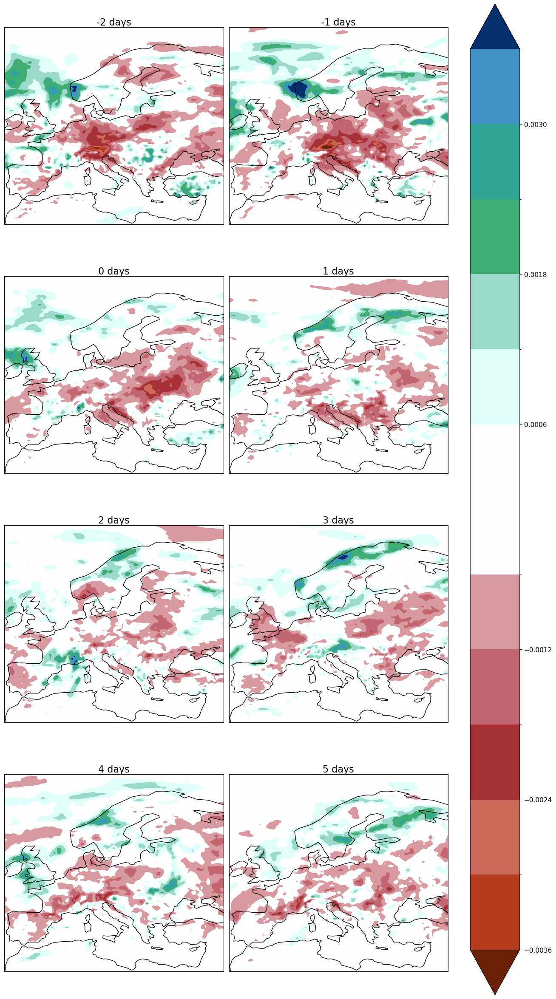

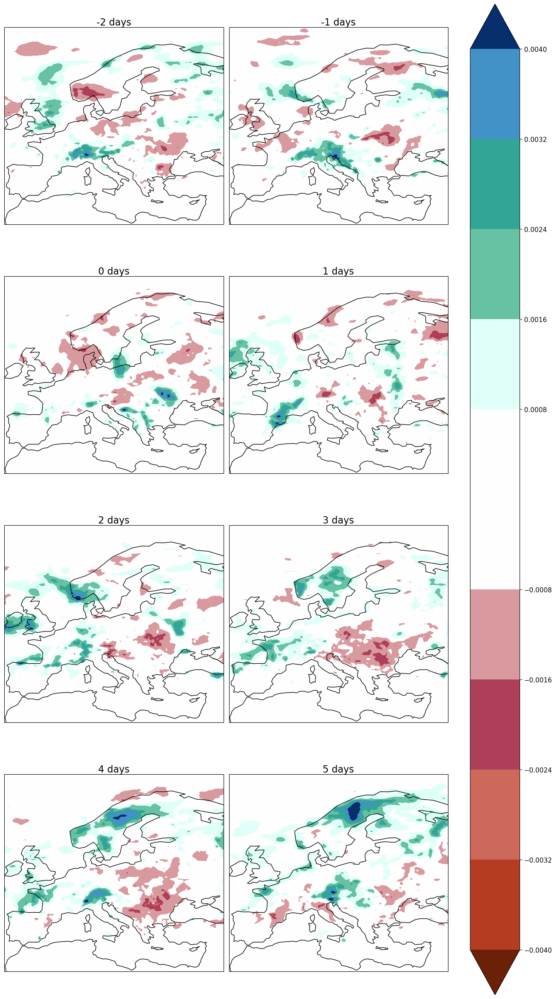

In [ ]:
da = da_tp.sel(lon=slice(-10, 45), lat=slice(30, 75)).copy()
da = compute(da.sel(time=da.time.dt.season == "JJA"))
plot_kwargs = {
    "cmap": colormaps.precip4_diff_19lev,
    "levels": 13,
    "q": 0.999,
    "transparify": 0,
}

clu = Clusterplot(4, 2, get_region(da))
spells_from_jet_daily = spells_list_time_before["STJ lifetime"]
to_plot = mask_from_spells_pl(spells_from_jet_daily, da)
n_spells = to_plot.spell.shape[0]
print(n_spells)
to_plot = to_plot.mean("spell").sel(relative_index=[-2, -1, 0, 1, 2, 3, 4, 5])
_ = clu.add_contourf(
    to_plot,
    titles=to_plot.relative_time.values.astype("timedelta64[D]"),
    **plot_kwargs
)

clu = Clusterplot(4, 2, get_region(da))
spells_from_jet_daily = spells_list_time_before["EDJ lifetime"]
to_plot = mask_from_spells_pl(spells_from_jet_daily, da)
n_spells = to_plot.spell.shape[0]
print(n_spells)
to_plot = to_plot.mean("spell").sel(relative_index=[-2, -1, 0, 1, 2, 3, 4, 5])
_ = clu.add_contourf(
    to_plot,
    titles=to_plot.relative_time.values.astype("timedelta64[D]"),
    **plot_kwargs
)

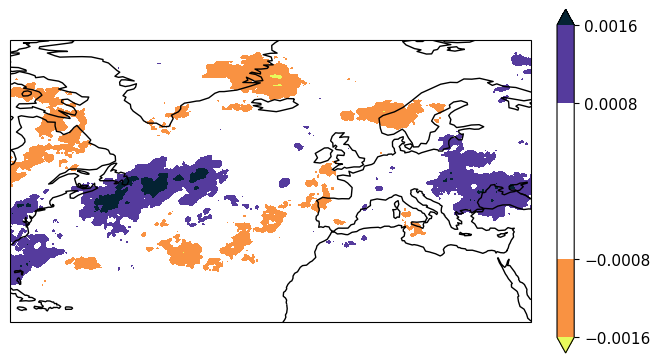

In [ ]:
clu = Clusterplot(1, 1, get_region(da_apvs))
_ = clu.add_contourf([compute(da_apvs.mean("time"), progress_bar=True)], cmap=colormaps.thermal_r, transparify=1)

23
24


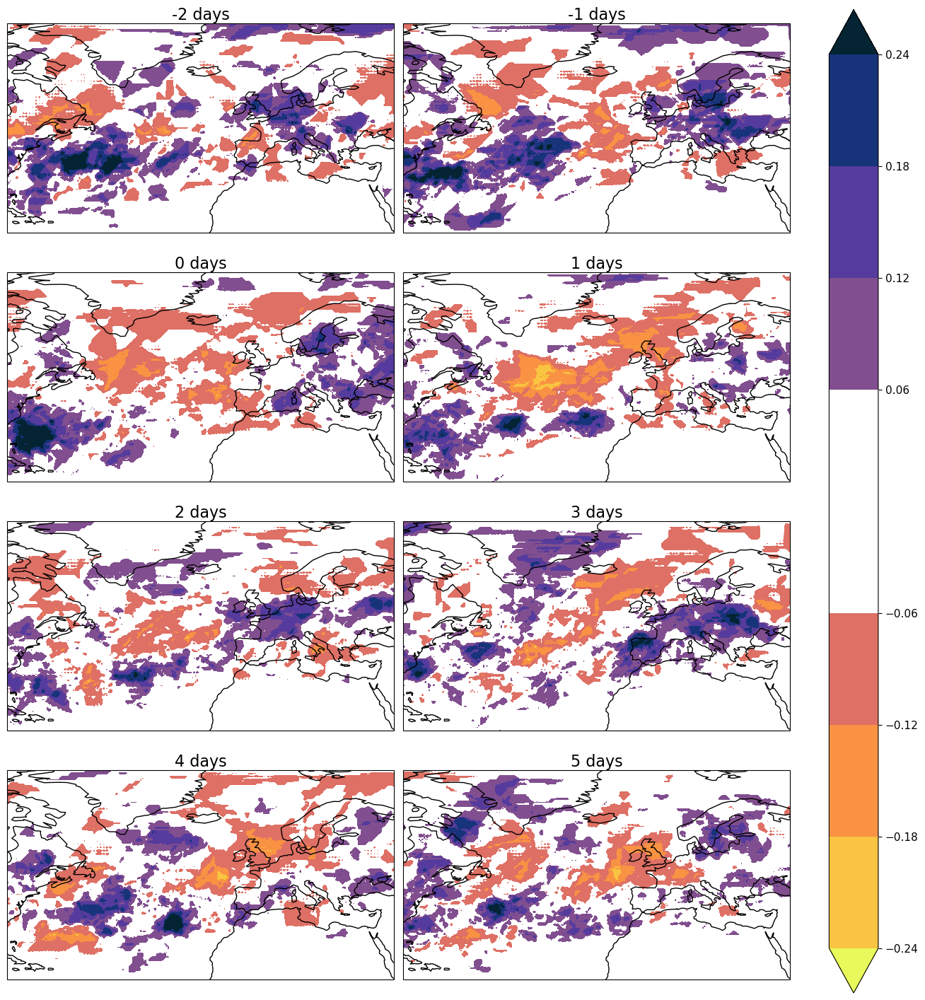

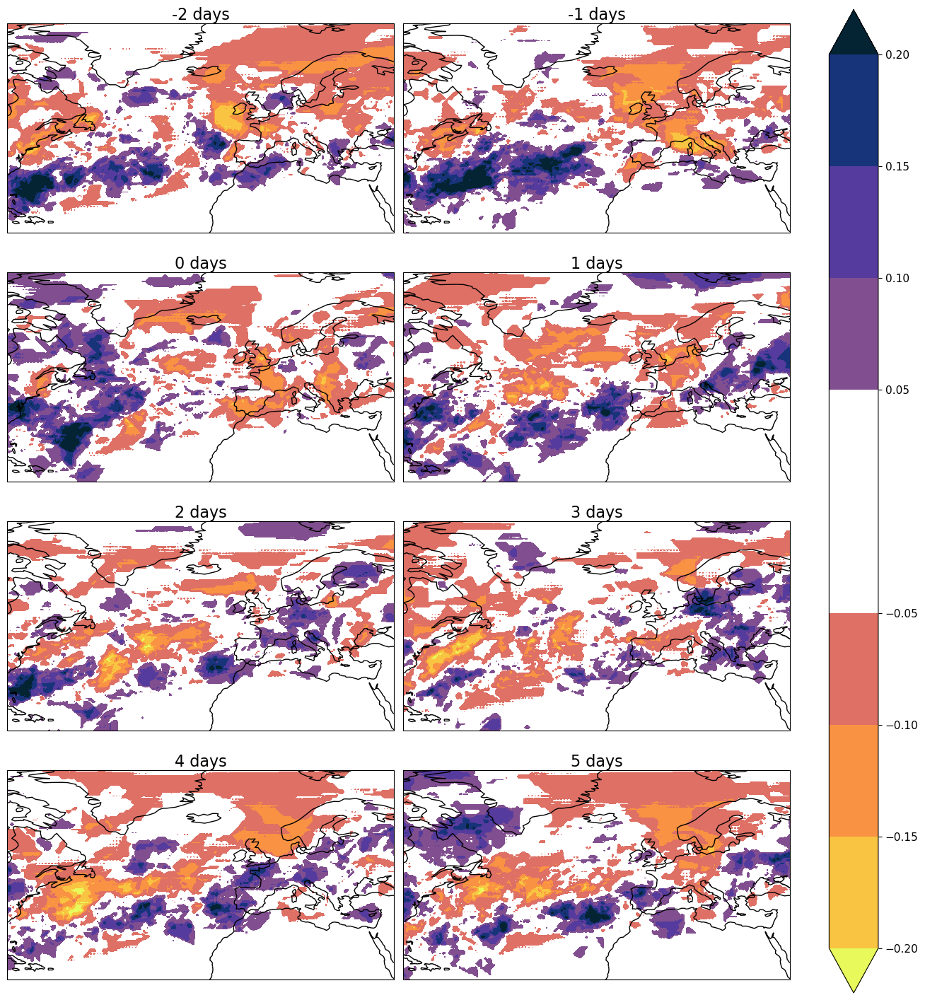

In [ ]:
da = da_apvs.copy()
da = compute(da.sel(time=da.time.dt.season == "JJA"))
plot_kwargs = {
    "cmap": colormaps.thermal_r,
    "levels": 7,
    "transparify": 1,
}

clu = Clusterplot(4, 2, get_region(da))
spells_from_jet_daily = spells_list_time_before["STJ lifetime"]
to_plot = mask_from_spells_pl(spells_from_jet_daily, da)
n_spells = to_plot.spell.shape[0]
print(n_spells)
to_plot = to_plot.mean("spell").sel(relative_index=[-2, -1, 0, 1, 2, 3, 4, 5])
_ = clu.add_contourf(
    to_plot,
    titles=to_plot.relative_time.values.astype("timedelta64[D]"),
    **plot_kwargs
)

clu = Clusterplot(4, 2, get_region(da))
spells_from_jet_daily = spells_list_time_before["EDJ lifetime"]
to_plot = mask_from_spells_pl(spells_from_jet_daily, da)
n_spells = to_plot.spell.shape[0]
print(n_spells)
to_plot = to_plot.mean("spell").sel(relative_index=[-2, -1, 0, 1, 2, 3, 4, 5])
_ = clu.add_contourf(
    to_plot,
    titles=to_plot.relative_time.values.astype("timedelta64[D]"),
    **plot_kwargs
)

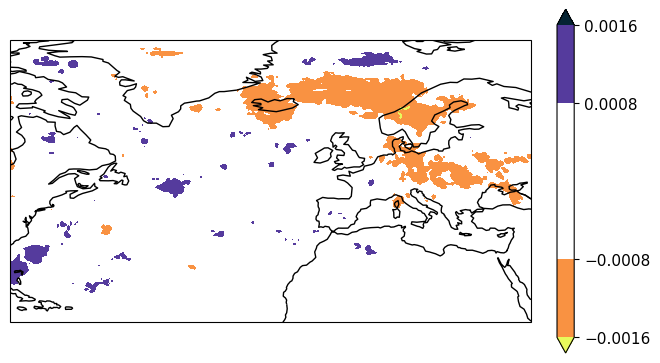

In [ ]:
clu = Clusterplot(1, 1, get_region(da_cpvs))
_ = clu.add_contourf([compute(da_cpvs.mean("time"), progress_bar=True)], cmap=colormaps.thermal_r, transparify=1)

23
24


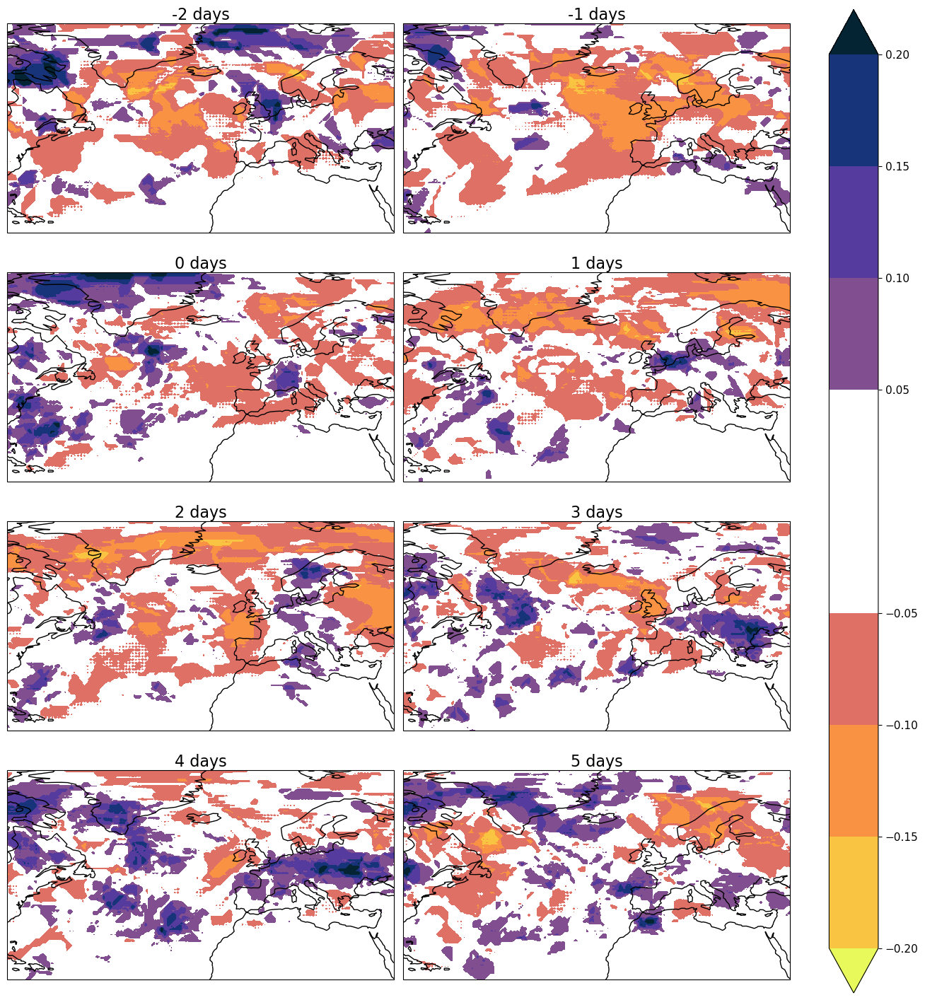

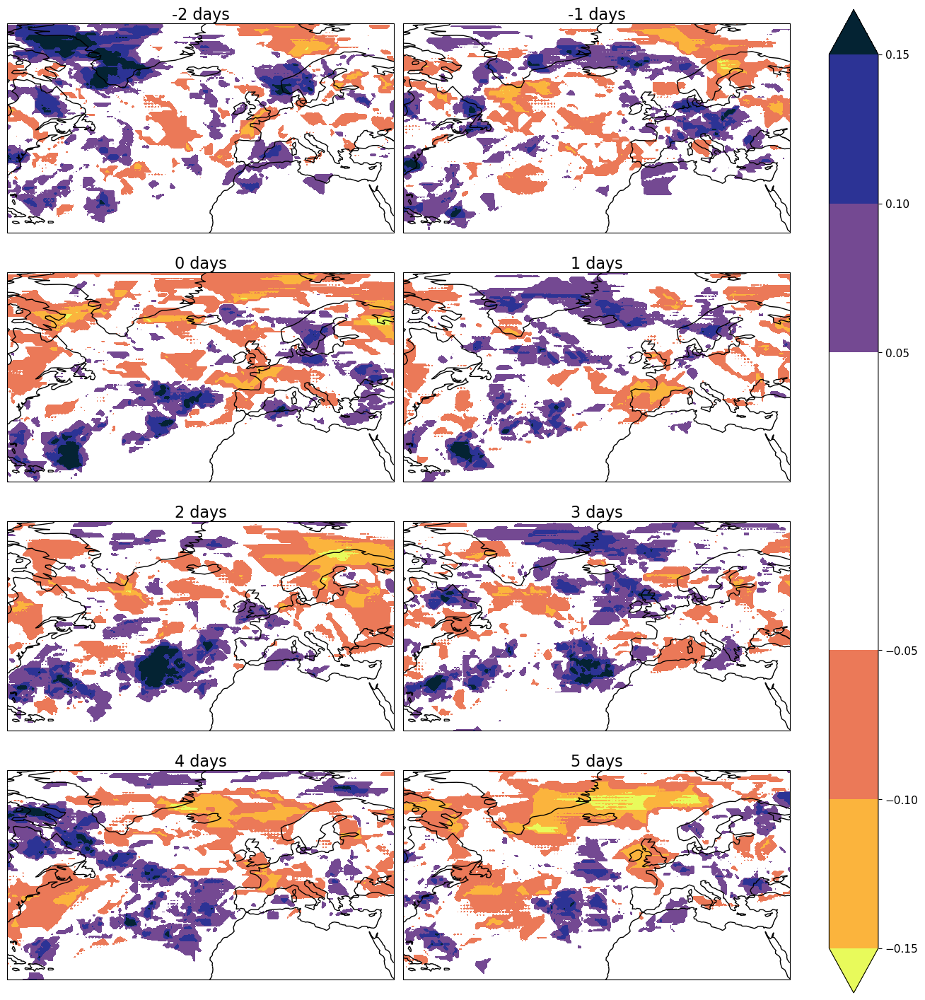

In [ ]:
da = da_cpvs.copy()
da = compute(da.sel(time=da.time.dt.season == "JJA"))
plot_kwargs = {
    "cmap": colormaps.thermal_r,
    "levels": 7,
    "transparify": 1,
}

clu = Clusterplot(4, 2, get_region(da))
spells_from_jet_daily = spells_list_time_before["STJ lifetime"]
to_plot = mask_from_spells_pl(spells_from_jet_daily, da)
n_spells = to_plot.spell.shape[0]
print(n_spells)
to_plot = to_plot.mean("spell").sel(relative_index=[-2, -1, 0, 1, 2, 3, 4, 5])
_ = clu.add_contourf(
    to_plot,
    titles=to_plot.relative_time.values.astype("timedelta64[D]"),
    **plot_kwargs
)

clu = Clusterplot(4, 2, get_region(da))
spells_from_jet_daily = spells_list_time_before["EDJ lifetime"]
to_plot = mask_from_spells_pl(spells_from_jet_daily, da)
n_spells = to_plot.spell.shape[0]
print(n_spells)
to_plot = to_plot.mean("spell").sel(relative_index=[-2, -1, 0, 1, 2, 3, 4, 5])
_ = clu.add_contourf(
    to_plot,
    titles=to_plot.relative_time.values.astype("timedelta64[D]"),
    **plot_kwargs
)